# Notebook to plan out the form of the optimal estimator

In [4]:
import numpy as np
import sys
sys.path.append('..')
import skewer_computations as skc
import os
import matplotlib.pyplot as plt
# from fake_spectra import spectra as spec
import time
%load_ext autoreload
%autoreload 2
import estimator as est
from numpy.random import Generator, PCG64
rng = np.random.default_rng(seed=315)

# Goal: estimate deviations from a fiducial Px spectrum

$$P_\times(z,\Delta \theta,k_\parallel) =  P_\times^{\rm
   fid}(z,\Delta \theta,k_\parallel) + \sum_\alpha ~ \Theta_\alpha(\Delta \theta) 
    ~ w^\times_\alpha(z, k_\parallel) ~ p^\times_\alpha ~ $$
    
$    w^\times_\alpha(z, k_\parallel)$ is an interpolation kernel, $ \Theta_\alpha(\Delta \theta) $ is top hat filter in transverse.  $p_\alpha = P^\times(k_\alpha) − P^\times_\mathrm{fid}(k_\alpha)$ are the cross-spectrum parameters we want to measure, i.e., the deviations from the fiducial power spectrum.

Define the bin we are going to measure.

In [2]:
separation_bins = [2, 2.5, 3]

distances = np.linalg.norm(positions-[0,0], axis=1)
dgrid = distances.reshape(position_grid.shape[0:2])

s=0
sbin = [separation_bins[0],separation_bins[1]]
m_offsets, n_offsets = skc.offsets_inbin(positions, position_grid.shape[0:2],sbin)

print(f"Plotting separations for bin {sbin}.")


dists_remain = []
for i in range(len(m_offsets)):
    dists_remain.append(dgrid[m_offsets[i], n_offsets[i]])
plt.hist(dists_remain)
print(len(dists_remain))

NameError: name 'positions' is not defined

# Define the first global weighting matrix by setting the fiducial Px for this separation.
However, if following F-R+18, the weighting matrix will be P1D at Delta-theta = 0 and 0 everywhere else.
So, we don't actually need to make the Px predictions. The following few boxes will be hidden.

In [9]:
from forestflow.model_p3d_arinyo import ArinyoModel
from forestflow.archive import GadgetArchive3D
from lace.cosmo import camb_cosmo
from forestflow import pcross
path_program = "/Users/mlokken/research/lyman_alpha/software/ForestFlow/"

folder_lya_data = path_program + "data/best_arinyo/"

Archive3D = GadgetArchive3D(
    base_folder=path_program[:-1],
    folder_data=folder_lya_data,
    force_recompute_plin=False,
    average="both",
)

In [10]:
# set snapnum
snap_num = 4
central = Archive3D.get_testing_data("mpg_central")
zs = np.array([central[snap_num]['z']]) 

k3d_Mpc = central[snap_num]['k3d_Mpc']
mu3d = central[snap_num]['mu3d']
p3d_Mpc = central[snap_num]['p3d_Mpc']
Plin = central[snap_num]['Plin']

k1d_Mpc = central[snap_num]['k_Mpc']
p1d_Mpc = central[snap_num]['p1d_Mpc']

arinyo_params = central[snap_num]['Arinyo'] # best-fitting Arinyo params
cosmo_params  = central[snap_num]['cosmo_params']

print(zs)
arinyo_params

[3.5]


{'bias': -0.34486724764089416,
 'beta': 0.9185428879634573,
 'q1': 0.5916161114683118,
 'kvav': 0.9115729485132611,
 'av': 0.5719766141289313,
 'bv': 1.9243983713618498,
 'kp': 13.839086476505287,
 'q2': 0.2823080933497336}

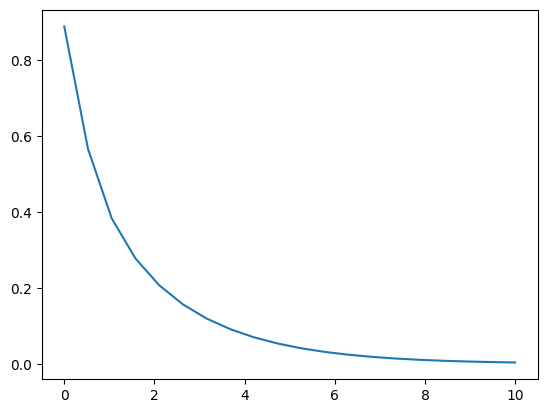

In [11]:
cosmo = camb_cosmo.get_cosmology_from_dictionary(cosmo_params)
camb_results = camb_cosmo.get_camb_results(cosmo, zs=zs, camb_kmax_Mpc=1000)
arinyo = ArinyoModel(cosmo=cosmo, camb_results=camb_results, zs=zs, camb_kmax_Mpc=1000)
p1d = arinyo.P1D_Mpc(zs[0], np.linspace(0,10,20), parameters=arinyo_params) # get P1D at target z
plt.plot(np.linspace(0,10,20), p1d)
# R2 = separation_bins[1]
# R1 = separation_bins[0]
# rperp_choice = 2/3. * (R2**3-R1**3)/(R2**2-R1**2)
# print(rperp_choice)
# rperp_pred,Px_per_kpar_pred = pcross.Px_Mpc_detailed(kpar[1:66],
# arinyo.P3D_Mpc,
# zs[0],
# rperp_choice=[rperp_choice],
# P3D_mode='pol',
# min_kperp=10**-3,
# nkperp=2**12,
# **{'pp':arinyo_params})

## Define the functions

### Load the data.
We're working in pixel space

In [12]:
# set sim_name
sim_name='sim_pair_30' # other version will be 'diffSeed'
sim_dir='central'

# set phase
phase = "sim_minus"
# set axis number
axis = 1


In [13]:
# # get the measurements for this set
meas_path = "/Users/mlokken/research/lyman_alpha/data/"
# Px_info = np.load(meas_path+"snap_{:d}/Px_skewers_{:.2f}_{:.2f}_allax_allphase.npz".format(snap_num,0.05,0.13))
# Px_meas_0 = Px_info['Px']
# L= Px_info['L']
# Np = int(Px_info['Np'])
# spacing = L/Np
# kpar_meas = np.fft.rfftfreq(Np, spacing)*2*np.pi # frequency in Mpc^-1

In [14]:
# load the skewers as npz file
delta_x = np.load(meas_path+"snap_{:d}/delta_x/skewers_4_psim_minus_ax1_Ns768_wM0.05_sT1.0_sg1.0.npz".format(snap_num))

In [15]:
delta_flux_x = delta_x['delta_flux_x'] # these are already normalized
Np = delta_flux_x.shape[1]
L = delta_x['L_Mpc']
pix_spacing = L/Np
print("pixel spacing is", pix_spacing, "Mpc")
xpar = delta_x['xpar'] # this is still wrong for some reason, redefined below
# delta_x['los_spacing_Mpc']

delta_x.close()

pixel spacing is 0.05 Mpc


In [16]:
xpar = np.arange(0, L, pix_spacing)+pix_spacing/2.

In [17]:
Np = delta_flux_x.shape[1]
nskew = delta_flux_x.shape[0]
# means = np.mean(delta_flux_x, axis=0)
nside = np.sqrt(nskew).astype(int)
print(f"Box is {L} Mpc per side with {nside} skewers per side")
print(f"Spacing between pixels along line-of-sight = {pix_spacing} Mpc")

# bin delta_flux along line-of-sight
binsize = 10
# binsize=30

if Np%binsize != 0:
    print("Np is not divisible by binsize")
    sys.exit()
delta_flux_b, xpar_b = est.bin_spectra(delta_flux_x, xpar, binsize)
# means_b = np.mean(delta_flux_b, axis=0)

Np_b=delta_flux_b.shape[1]
pix_spacing_b = xpar_b[1]-xpar_b[0]
print(f"Spacing between pixels along line-of-sight after binning = {pix_spacing_b} Mpc")

# get the positions
xpos = np.linspace(0,L,nside)
ypos = np.linspace(0,L,nside)
print("spacing between neighboring skewers is {:.2f} Mpc".format(xpos[1]-xpos[0]))
positions = np.array([[x,y] for x in xpos for y in ypos])
subsel=True
nsub=100
if subsel:
    randoms = rng.choice(len(positions), size=nsub)
    sel = np.zeros(len(positions), dtype=bool)
    sel[randoms] = True
else:
    sel = np.ones(len(positions), dtype=bool)
positions_sel = np.copy(positions)
positions_sel[~sel] = np.nan
delta_flux_x[~sel] = np.nan
delta_flux_b[~sel] = np.nan


# reshape into a grid
delta_flux_x = np.reshape(delta_flux_x, (int(nside), int(nside), Np))
delta_flux_b = np.reshape(delta_flux_b, (int(nside), int(nside), Np_b))
position_grid = np.reshape(positions_sel, (int(nside), int(nside), 2))

Box is 67.5 Mpc per side with 768 skewers per side
Spacing between pixels along line-of-sight = 0.05 Mpc
Number of bins: 135


Spacing between pixels along line-of-sight after binning = 0.49999999999999994 Mpc
spacing between neighboring skewers is 0.09 Mpc


In [18]:
xpar_b

array([ 0.25,  0.75,  1.25,  1.75,  2.25,  2.75,  3.25,  3.75,  4.25,
        4.75,  5.25,  5.75,  6.25,  6.75,  7.25,  7.75,  8.25,  8.75,
        9.25,  9.75, 10.25, 10.75, 11.25, 11.75, 12.25, 12.75, 13.25,
       13.75, 14.25, 14.75, 15.25, 15.75, 16.25, 16.75, 17.25, 17.75,
       18.25, 18.75, 19.25, 19.75, 20.25, 20.75, 21.25, 21.75, 22.25,
       22.75, 23.25, 23.75, 24.25, 24.75, 25.25, 25.75, 26.25, 26.75,
       27.25, 27.75, 28.25, 28.75, 29.25, 29.75, 30.25, 30.75, 31.25,
       31.75, 32.25, 32.75, 33.25, 33.75, 34.25, 34.75, 35.25, 35.75,
       36.25, 36.75, 37.25, 37.75, 38.25, 38.75, 39.25, 39.75, 40.25,
       40.75, 41.25, 41.75, 42.25, 42.75, 43.25, 43.75, 44.25, 44.75,
       45.25, 45.75, 46.25, 46.75, 47.25, 47.75, 48.25, 48.75, 49.25,
       49.75, 50.25, 50.75, 51.25, 51.75, 52.25, 52.75, 53.25, 53.75,
       54.25, 54.75, 55.25, 55.75, 56.25, 56.75, 57.25, 57.75, 58.25,
       58.75, 59.25, 59.75, 60.25, 60.75, 61.25, 61.75, 62.25, 62.75,
       63.25, 63.75,

-0.06852293362805546
-0.06852293362805545
-0.15492664195594683
-0.15492664195594685
-0.3052156639427566
-0.3052156639427567


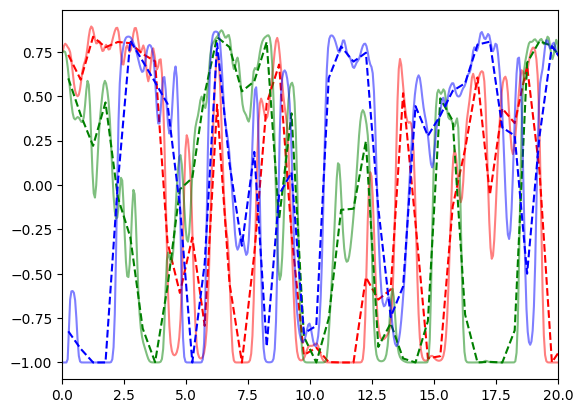

plotted 3 spectra


In [19]:
colors=['r','g','b','c','m','y','k']
# plot the spectra that are not nan
counter = 0

for i in range(nside//4):
    for j in range(nside//4):
        if np.isnan(delta_flux_x[i,j]).any():
            continue
        else:
            if counter<3:
                plt.plot(xpar, delta_flux_x[i,j], label='unbinned', color=colors[counter%7], alpha=.5)
                plt.plot(xpar_b, delta_flux_b[i,j], label='binned', color=colors[counter%7], linestyle='--', alpha=1)
                # plt.plot(xpar, delta_flux_x[i,j])
                counter += 1
                print(np.mean(delta_flux_x[i,j]))
                print(np.mean(delta_flux_b[i,j]))
plt.xlim([0,20])
# plt.legend()
plt.show()
print(f"plotted {counter} spectra")

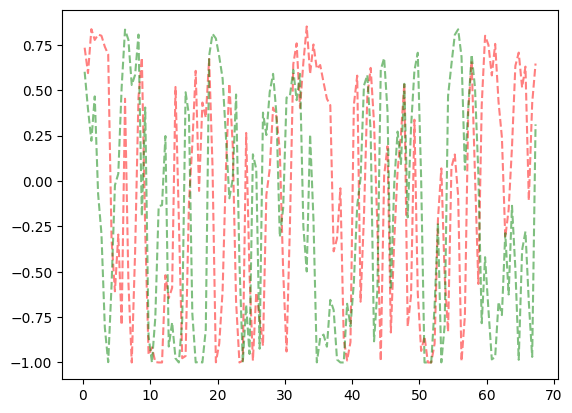

plotted 2 spectra


In [20]:

counter = 0

for i in range(nside//5):
    for j in range(nside//5):
        if np.isnan(delta_flux_x[i,j]).any():
            continue
        else:
            if counter<10:
                plt.plot(xpar_b, delta_flux_b[i,j], color=colors[counter%7], linestyle='--', alpha=.5)
                counter += 1

plt.show()
print(f"plotted {counter} spectra")

In [21]:
# # specify path to test simulations
# data_path = "/data/desi/common/HydroData/Emulator/post_768/Australia20" # in PIC
# # specify simulation in suite
# sk_fname="skewers_{}_Ns768_wM0.05_sT1.0_sg1.0.hdf5".format(snap_num)
# subsel = True
# if not os.path.exists("/data/desi/scratch/mlokken/Px_skewers/{}/snap_{}/skewers_{}_Ns768_wM0.05_sT1.0_sg1.0_{}_p{}_skew{}.npy".format(sim_dir, snap_num, snap_num,sim_name, phase, axis)):
#     print("Collecting spectra for phase {}, skewer {}".format(phase, axis))
#     sk_dir="{}/{}/{}/skewers_{}".format(data_path,sim_name, phase, axis)
#     # reconstruct filename with skewers
#     print("will load skewers from file {} in directory {}".format(sk_fname,sk_dir))
#     # create Spectra object from fake_spectra repo
#     spectra = spec.Spectra(num=snap_num,base="NA",cofm=None,axis=None,savedir=sk_dir,savefile=sk_fname,
#                      res=None,reload_file=False,load_snapshot=False,quiet=False)
#     Lh = spectra.box/1000
#     L = Lh/spectra.hubble
#     print(f"Box is {L} Mpc per side")
#     z = spectra.red
#     if axis==1:
#         axes = [1,2] # yz plane
#     elif axis==2:
#         axes = [0,2] # xz plane
#     elif axis==3:
#         axes = [0,1]
#     pos1 = spectra.cofm[:,axes[0]]/1000/spectra.hubble
#     pos2 = spectra.cofm[:,axes[1]]/1000/spectra.hubble
#     positions = np.column_stack([pos1,pos2])

#     if subsel:
#         randoms = np.random.choice(len(positions), size=500)
#         sel = np.zeros(len(positions), dtype=bool)
#         sel[randoms] = True
#     else:
#         sel = np.ones(len(pos1), dtype=bool)
#     positions_sel = np.copy(positions)
#     positions_sel[~sel] = np.nan
#     nside = int(np.sqrt(len(pos1)))
#     position_grid       = positions.reshape((nside,nside,2))
#     position_grid_sel   = positions_sel.reshape((nside,nside,2))
#     delta_flux=skc.delta(spectra.get_tau('H',1,1215))
#     delta_flux[~sel] = np.nan
#     Ns,Np=delta_flux.shape
#     pix_spacing = L/Np
#     print(f"Spacing between pixels along line-of-sight = {pix_spacing} Mpc")
#     # bin delta_flux along line-of-sight
#     delta_flux_binned = bin_spectra(delta_flux, 20)

#     Ns_b,Np_b=delta_flux_binned.shape
#     pix_spacing = L/Np_b
#     print(f"Spacing between pixels along line-of-sight after binning = { pix_spacing} Mpc")
#     delta_flux_grid = delta_flux_binned.reshape((nside,nside,Np_b))=/`;pip `

Our sub-selected spectra are distributed randomly across the plane:

Text(0, 0.5, 'y [Mpc]')

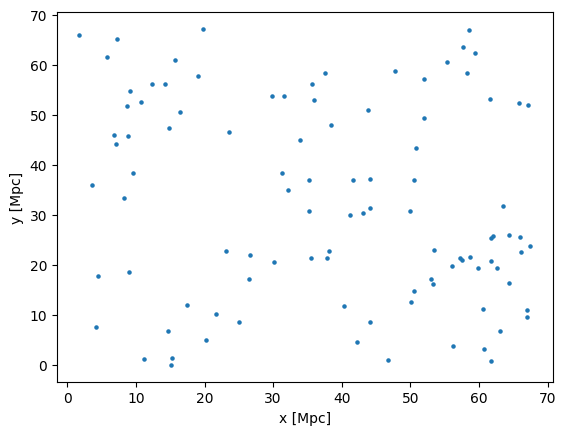

In [22]:
plt.scatter(positions_sel[:,0], positions_sel[:,1], s=5)
plt.xlabel("x [Mpc]")
plt.ylabel("y [Mpc]")

# Run the algorithm

### Choose the binning

In [23]:
# get the kpar that will correspond to the xpar
kpar_b = np.fft.rfftfreq(Np_b, pix_spacing_b)*2*np.pi # frequency in Mpc^-1
kpar   = np.fft.rfftfreq(Np, pix_spacing)*2*np.pi # frequency in Mpc^-1

In [24]:
# make a set of bins with kpar[1:] as centers
# kbin_est = (kpar_b+(kpar_b[1]-kpar_b[0])/2)[:20]
kbin_est = [[kp-0.01, kp+0.01] for kp in kpar_b[1:-1]]
# kbin_est = [kbin_est[0], kbin_est[2], kbin_est[4], kbin_est[6], kbin_est[8], kbin_est[10], kbin_est[12]]
print(kpar_b)
print(kbin_est)

[0.         0.09308423 0.18616845 0.27925268 0.37233691 0.46542113
 0.55850536 0.65158959 0.74467381 0.83775804 0.93084227 1.02392649
 1.11701072 1.21009495 1.30317917 1.3962634  1.48934763 1.58243186
 1.67551608 1.76860031 1.86168454 1.95476876 2.04785299 2.14093722
 2.23402144 2.32710567 2.4201899  2.51327412 2.60635835 2.69944258
 2.7925268  2.88561103 2.97869526 3.07177948 3.16486371 3.25794794
 3.35103216 3.44411639 3.53720062 3.63028484 3.72336907 3.8164533
 3.90953752 4.00262175 4.09570598 4.1887902  4.28187443 4.37495866
 4.46804289 4.56112711 4.65421134 4.74729557 4.84037979 4.93346402
 5.02654825 5.11963247 5.2127167  5.30580093 5.39888515 5.49196938
 5.58505361 5.67813783 5.77122206 5.86430629 5.95739051 6.05047474
 6.14355897 6.23664319]
[[0.08308422677303093, 0.10308422677303092], [0.17616845354606184, 0.19616845354606186], [0.2692526803190928, 0.2892526803190928], [0.3623369070921237, 0.3823369070921237], [0.4554211338651546, 0.4754211338651546], [0.5485053606381856, 0.56

In [25]:
delta_x_matrix = est.make_delta_x_matrix(L, Np, xpar)
delta_x_matrix_binned = est.make_delta_x_matrix(L, Np_b, xpar_b)


In [26]:
xpar_b

array([ 0.25,  0.75,  1.25,  1.75,  2.25,  2.75,  3.25,  3.75,  4.25,
        4.75,  5.25,  5.75,  6.25,  6.75,  7.25,  7.75,  8.25,  8.75,
        9.25,  9.75, 10.25, 10.75, 11.25, 11.75, 12.25, 12.75, 13.25,
       13.75, 14.25, 14.75, 15.25, 15.75, 16.25, 16.75, 17.25, 17.75,
       18.25, 18.75, 19.25, 19.75, 20.25, 20.75, 21.25, 21.75, 22.25,
       22.75, 23.25, 23.75, 24.25, 24.75, 25.25, 25.75, 26.25, 26.75,
       27.25, 27.75, 28.25, 28.75, 29.25, 29.75, 30.25, 30.75, 31.25,
       31.75, 32.25, 32.75, 33.25, 33.75, 34.25, 34.75, 35.25, 35.75,
       36.25, 36.75, 37.25, 37.75, 38.25, 38.75, 39.25, 39.75, 40.25,
       40.75, 41.25, 41.75, 42.25, 42.75, 43.25, 43.75, 44.25, 44.75,
       45.25, 45.75, 46.25, 46.75, 47.25, 47.75, 48.25, 48.75, 49.25,
       49.75, 50.25, 50.75, 51.25, 51.75, 52.25, 52.75, 53.25, 53.75,
       54.25, 54.75, 55.25, 55.75, 56.25, 56.75, 57.25, 57.75, 58.25,
       58.75, 59.25, 59.75, 60.25, 60.75, 61.25, 61.75, 62.25, 62.75,
       63.25, 63.75,

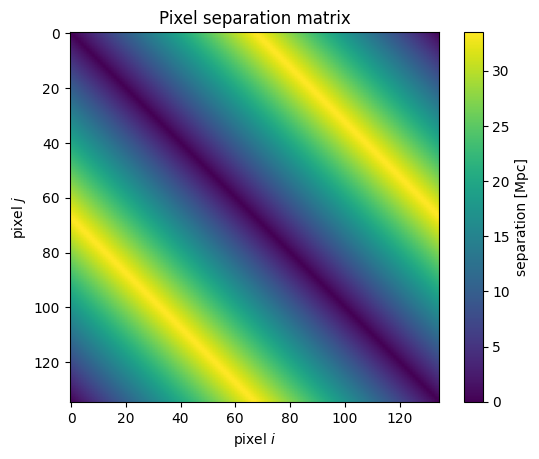

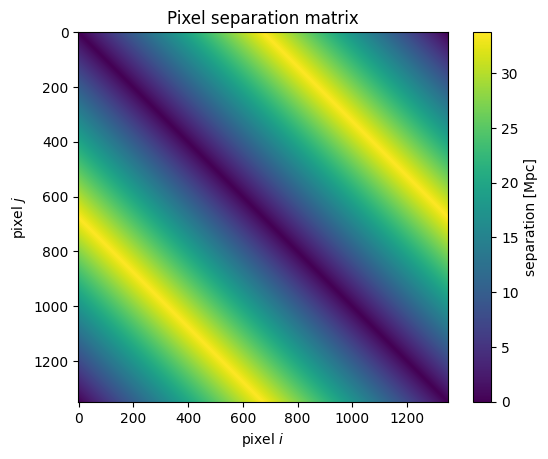

<Figure size 640x480 with 0 Axes>

In [27]:
plt.imshow(delta_x_matrix_binned)
plt.title("Pixel separation matrix")
plt.xlabel(r"pixel $i$")
plt.ylabel(r"pixel $j$")
plt.colorbar(label="separation [Mpc]")
plt.show()
plt.clf()
plt.imshow(delta_x_matrix)
plt.title("Pixel separation matrix")
plt.xlabel(r"pixel $i$")
plt.ylabel(r"pixel $j$")
plt.colorbar(label="separation [Mpc]")
plt.show()
plt.clf()
# # get the matrix of kpar values corresponding to each delta-x
# kpar_matrix_binned = 2*np.pi / delta_x_matrix_binned
# kpar_matrix = 2*np.pi / delta_x_matrix

# plt.imshow(kpar_matrix_binned, vmax=1)
# plt.title("kpar matrix")
# plt.colorbar()

In [28]:
# print("This is the highest k mode with this spacing,", kpar_matrix_binned[0,1])
# print("This is the lowest k mode with this spacing,", kpar_matrix_binned[0,-1])
# print("We can only expect to measure up to ", kpar_b[-1], "the Nyquist frequency which should be half the sampling frequency, and down to", kpar_b[1])

Text(0.5, 0, 'k [Mpc^-1]')

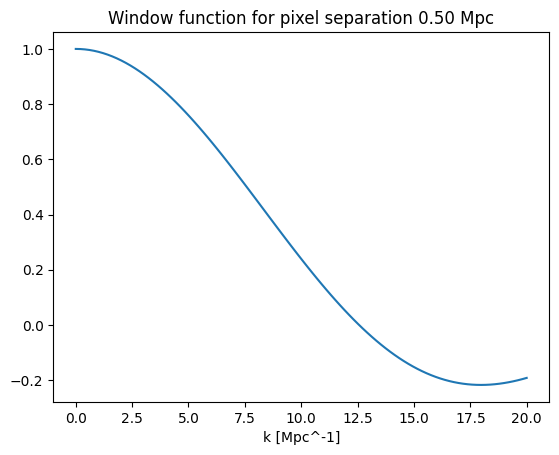

In [29]:
rand_k = np.linspace(0,20,100)
plt.plot(rand_k, est.w_k(rand_k, pix_spacing_b))
plt.title("Window function for pixel separation {:.2f} Mpc".format(pix_spacing_b))
plt.xlabel("k [Mpc^-1]")

In [30]:
import estimator as est

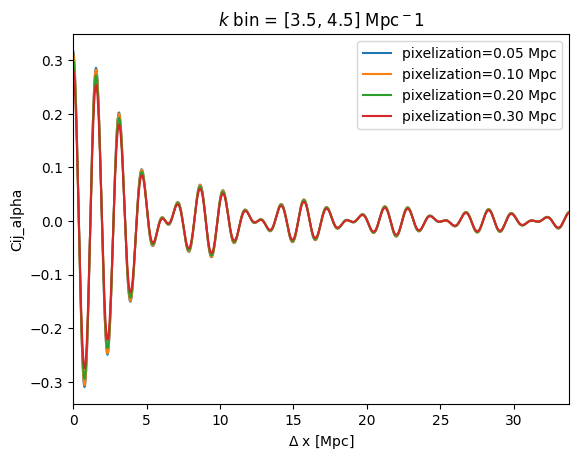

In [31]:
kbin = [3.50,4.5]
Nk_full = 100000
kmax = 200
kpar_range_full = np.linspace(0, kmax, Nk_full)
kspacing_full = kmax / Nk_full
for pixelization in [pix_spacing, pix_spacing*2, pix_spacing*4, pix_spacing*6]:
    f_k = est.w_k(kpar_range_full, pixelization) ** 2
    # set the function to zero outside the kbin
    f_k[kpar_range_full > kbin[1]] = 0
    f_k[kpar_range_full < kbin[0]] = 0

    # plt.plot(kpar_range_full, f_k)
    # plt.xlabel("kpar")
    # plt.ylabel("$W_k^2$")
    # plt.axvline(kbin[0], color="black", linestyle="--")
    # plt.axvline(kbin[1], color="black", linestyle="--")
    # plt.xlim([0, 10])
    # plt.show()
    # plt.clf()
    f_x_full = (
        np.fft.irfft(f_k) * Nk_full * kspacing_full / (np.pi) 
    )  # into units of Mpc-1 ?
    delta_x_spacing = np.pi / (kpar_range_full[-1] - kpar_range_full[0]) # something wrong with this line?
    # print(delta_x_spacing, "compared to Nyquist frequency", np.pi/kmax)
    Nx = 2 * (Nk_full - 1)
    x = np.arange(Nx) * delta_x_spacing
    plt.plot(x, f_x_full, label="pixelization={:.2f} Mpc".format(pixelization))
plt.xlim([0, np.amax(delta_x_matrix)])
plt.xlabel(r"$\Delta$ x [Mpc]")
plt.ylabel("Cij_alpha")
plt.title(f"$k$ bin = {kbin} Mpc$^{-1}$")
plt.legend()

k =  0.12139818461084304 Fig 1a
k =  0.016186424614779073 Fig 1b


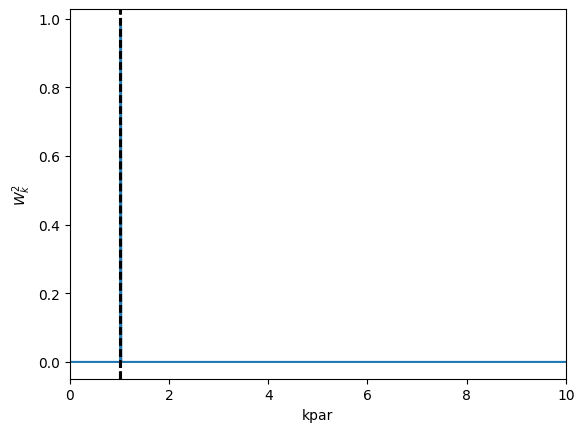

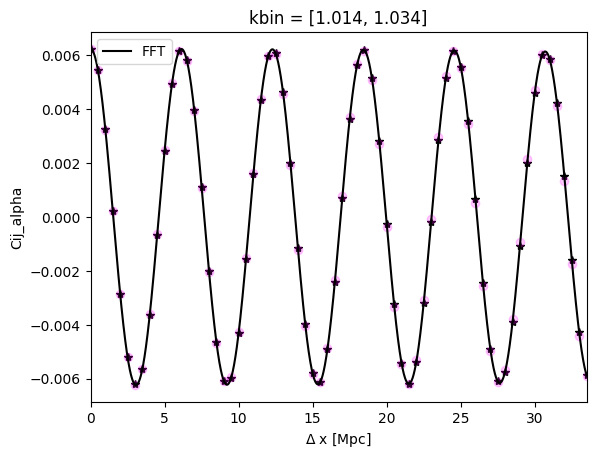

In [32]:
# print conversions from Andreu paper
print("k = ", .0015 * camb_cosmo.dkms_dMpc(cosmo, zs[0], camb_results=camb_results), "Fig 1a")
print("k = ", .0002 * camb_cosmo.dkms_dMpc(cosmo, zs[0], camb_results=camb_results), "Fig 1b")

Cij_alpha_matrix = est.cij_alpha(Np_b, kbin_est[10], delta_x_matrix_binned, pix_spacing_b, plot=True)


In [33]:
# # compare Cij_alpha to Cij_alpha_approx
# kbin = [kpar_b[2], kpar_b[3]]
# Cij_alpha_matrix = Cij_alpha(Np_b, kpar_matrix_binned, kbin, delta_x_matrix_binned, pix_spacing_b)
# Cij_alpha_matrix_approx = Cij_alpha_approx(Np_b, kpar_matrix_binned, kbin, delta_x_matrix_binned, pix_spacing_b)
# plt.imshow(Cij_alpha_matrix)
# plt.colorbar()
# plt.title("Cij_alpha")
# plt.show()
# plt.imshow(Cij_alpha_matrix_approx)
# plt.colorbar()
# plt.title("Cij_alpha_approx")
# plt.show()
# plt.imshow(Cij_alpha_matrix-Cij_alpha_matrix_approx)
# plt.colorbar()
# plt.title("Difference")
# plt.show()

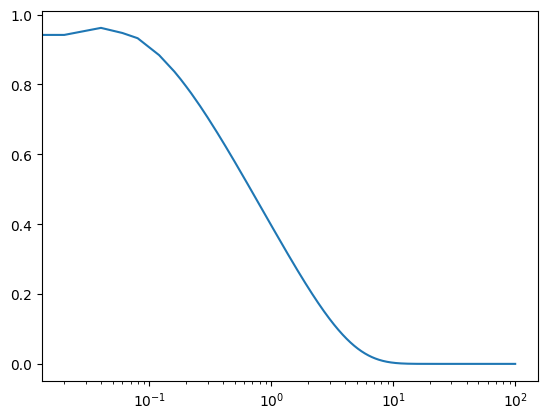

In [34]:
plt.semilogx(np.linspace(0,100,5000), arinyo.P1D_Mpc(zs[0], np.linspace(0,100,5000), parameters=arinyo_params))

In [35]:
Leff=1000
Np_fine=40000
xfine=np.linspace(0.0,Leff,Np_fine)
spacing_fine=Leff/Np_fine
kfine = np.fft.rfftfreq(Np_fine, spacing_fine)*2*np.pi
p1d_fine = arinyo.P1D_Mpc(zs[0], kfine, parameters=arinyo_params)
# for testing @ z=2.2:
# arinyo_params = central[9]['Arinyo'] # best-fitting Arinyo params
# camb_results = camb_cosmo.get_camb_results(cosmo, zs=[2.2], camb_kmax_Mpc=1000)
# p1d_fine = ArinyoModel(cosmo=cosmo, camb_results=camb_results, zs=[2.2], camb_kmax_Mpc=1000).P1D_Mpc(2.2, kfine, parameters=arinyo_params)

print(len(p1d_fine))
xi_fid = np.fft.irfft(p1d_fine) / spacing_fine # to cancel the Mpc. Might just be * Np_fine, not sure
# normalize
# pix_spacing_b/Np_b


20001


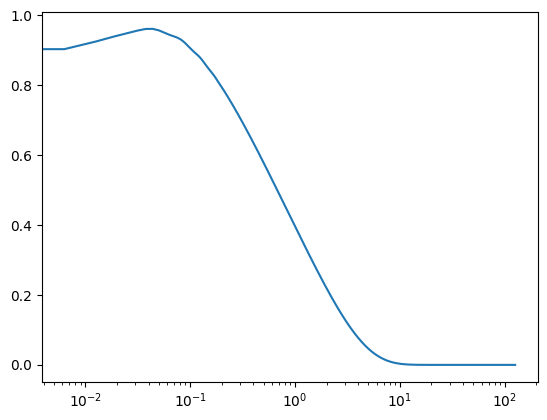

In [36]:
plt.semilogx(kfine, p1d_fine)

Text(0, 0.5, '$\\xi$')

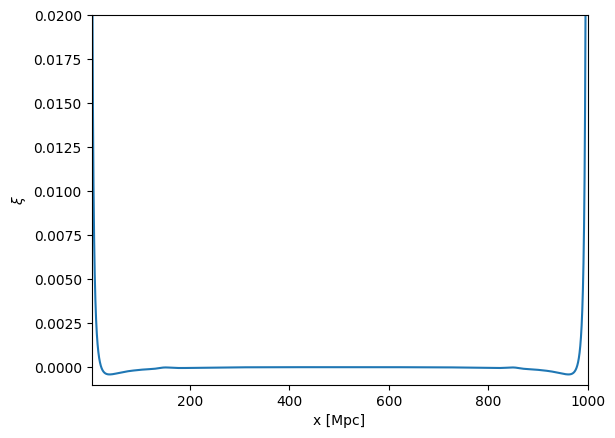

In [37]:
plt.plot(xfine, xi_fid)
# plt.xlim([10**-2.5,300])
plt.xlim([2.14, 1000])
plt.ylim([-.001,0.02])
plt.xlabel("x [Mpc]")
plt.ylabel(r"$\xi$")

In [38]:
where_200Mpc = np.where(xfine>200)[0]
xi_fid[where_200Mpc] = xi_fid[where_200Mpc[0]]
# make a function of it
from scipy.interpolate import interp1d
xi_fid_func = interp1d(xfine, xi_fid, kind='slinear', fill_value='extrapolate')

Text(0, 0.5, '$\\xi$')

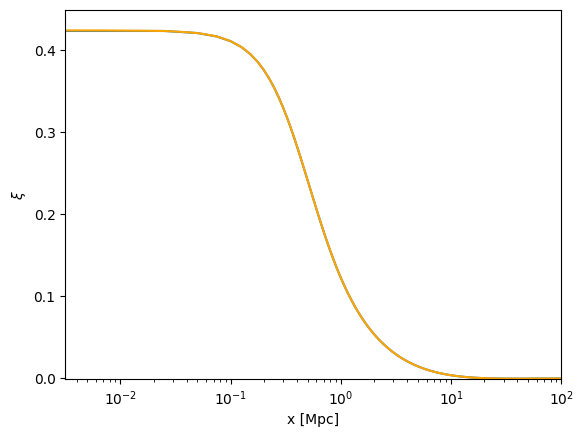

In [39]:
plt.semilogx(xfine, xi_fid)
plt.semilogx(np.logspace(-3,3,1000), xi_fid_func(np.logspace(-3,3,1000)), color='orange')
plt.xlim([10**-2.5,10**2])
plt.ylim([-.001,0.45])
plt.xlabel("x [Mpc]")
plt.ylabel(r"$\xi$")

Text(0, 0.5, '$\\xi$')

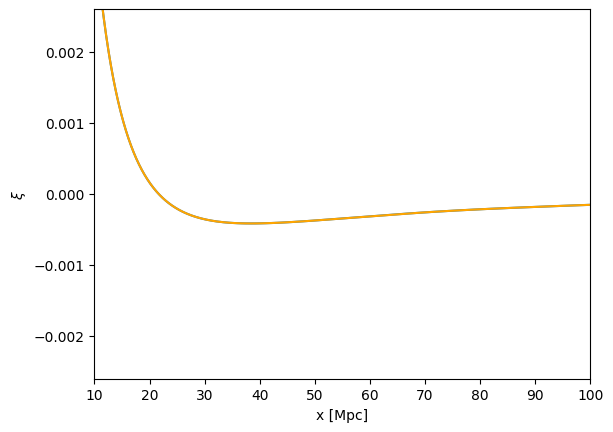

In [40]:
plt.plot(xfine, xi_fid)
plt.plot(np.logspace(-3,3,1000), xi_fid_func(np.logspace(-3,3,1000)), color='orange')
plt.xlim([10,10**2])
plt.ylim([-.0026,.0026])
plt.xlabel("x [Mpc]")
plt.ylabel(r"$\xi$")

In [41]:
C_0_mat_binned = est.c0(xi_fid_func, delta_x_matrix_binned)
C_0_mat = est.c0(xi_fid_func, delta_x_matrix)

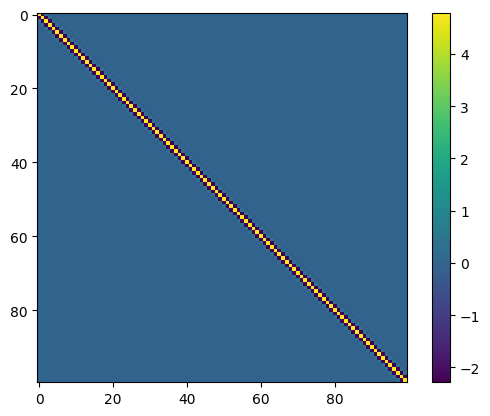

In [42]:
C_0_invmat = np.linalg.inv(C_0_mat)

C_0_invmat_binned = np.linalg.inv(C_0_mat_binned)
plt.imshow(C_0_invmat_binned[0:100,0:100])
plt.colorbar()

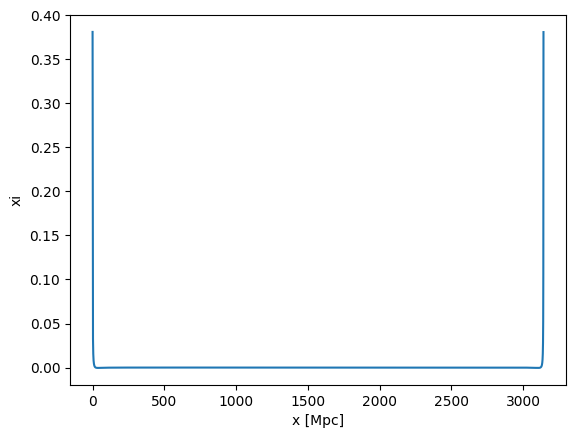

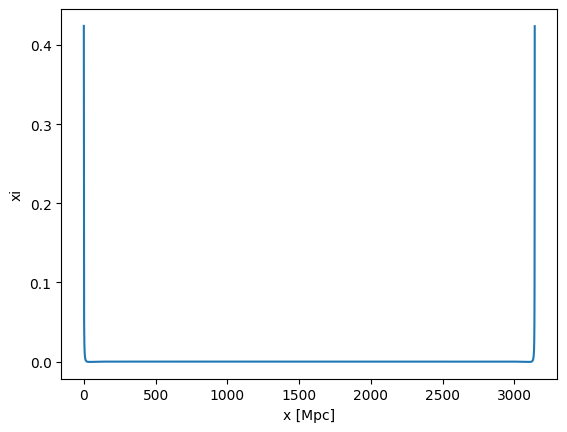

<Figure size 640x480 with 0 Axes>

In [43]:
# # check the fiducial signal
S_fiducial_b = est.s_fid(arinyo, zs[0], arinyo_params, delta_x_matrix_binned, pix_spacing_b, plot=True)
S_fiducial   = est.s_fid(arinyo, zs[0], arinyo_params, delta_x_matrix, pix_spacing, plot=True)

Text(0.5, 0.98, 'Relationship of convolved signal matrix to theoretical one')

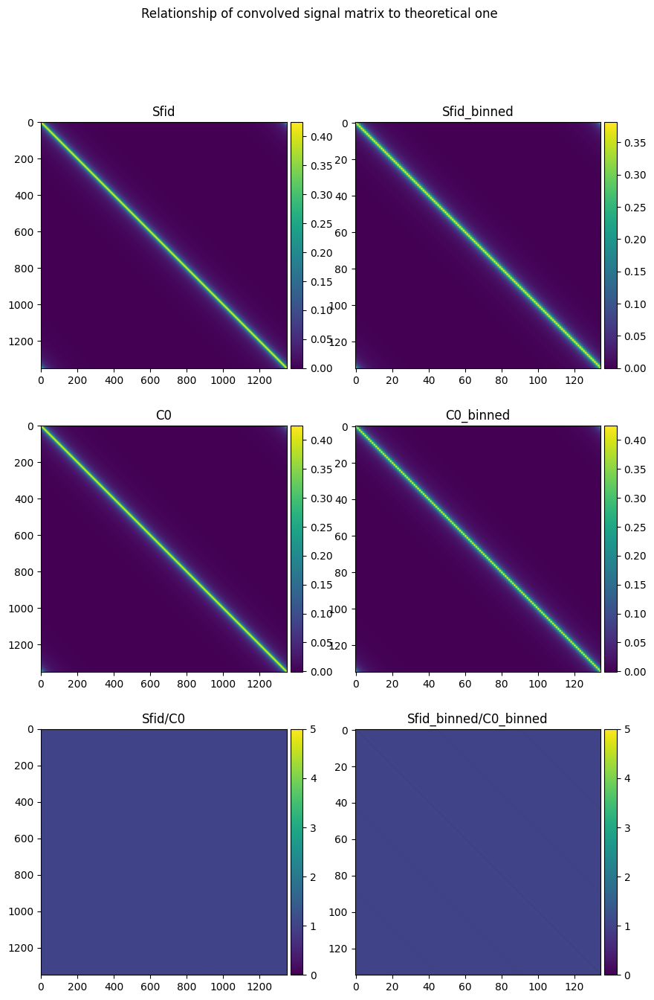

In [44]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, ax= plt.subplots(3, 2, figsize=(10,15))
im1 = ax[0,0].imshow(S_fiducial)
im2 = ax[0,1].imshow(S_fiducial_b)
im4 = ax[1,0].imshow(C_0_mat)
im3 = ax[1,1].imshow(C_0_mat_binned)
im5 = ax[2,0].imshow(S_fiducial / C_0_mat, vmin=0, vmax=5)
im6 = ax[2,1].imshow(S_fiducial_b / C_0_mat_binned, vmin=0, vmax=5)
# colorbar for all
divider = make_axes_locatable(ax[0,0])
cax1 = divider.append_axes("right", size="5%", pad=0.05)

divider = make_axes_locatable(ax[0,1])
cax2 = divider.append_axes("right", size="5%", pad=0.05)

divider = make_axes_locatable(ax[1,0])
cax3 = divider.append_axes("right", size="5%", pad=0.05)

divider = make_axes_locatable(ax[1,1])
cax4 = divider.append_axes("right", size="5%", pad=0.05)

divider = make_axes_locatable(ax[2,0])
cax5 = divider.append_axes("right", size="5%", pad=0.05)

divider = make_axes_locatable(ax[2,1])
cax6 = divider.append_axes("right", size="5%", pad=0.05)

fig.colorbar(im1, cax=cax1, orientation='vertical')
fig.colorbar(im2, cax=cax2, orientation='vertical')
fig.colorbar(im3, cax=cax3, orientation='vertical')
fig.colorbar(im4, cax=cax4, orientation='vertical')
fig.colorbar(im5, cax=cax5, orientation='vertical')
fig.colorbar(im6, cax=cax6, orientation='vertical')
titles = ['Sfid', 'Sfid_binned', 'C0', 'C0_binned', 'Sfid/C0', 'Sfid_binned/C0_binned']
for i in range(3):
    for j in range(2):
        ax[i,j].set_title(titles[i*2+j])
plt.suptitle("Relationship of convolved signal matrix to theoretical one")


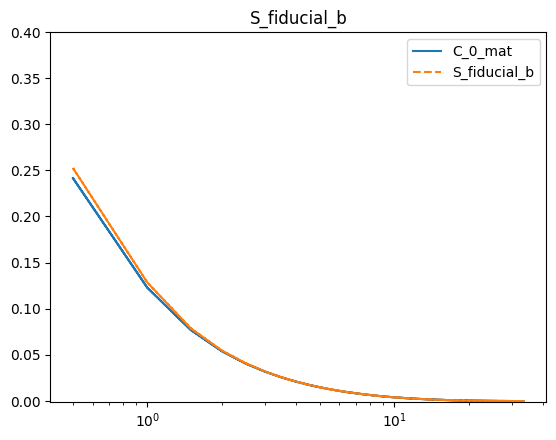

In [45]:
# plot the cross-diagonal to take a slice through the matrices (removing redundant info)
def plot_cross_diag(matrix, sep_matrix, title, c, linestyles=['solid', '--','dotted']):
    # n = matrix.shape[0]
    # cross_diag = [matrix[i, n-i-1] for i in range(n)]
    # cross_diag_sep_matrix = [sep_matrix[i, n-i-1] for i in range(n)]
    cross_diag_sep_matrix = np.diag(np.fliplr(sep_matrix))
    cross_diag = np.diag(np.fliplr(matrix))
    plt.semilogx(cross_diag_sep_matrix, cross_diag, label=title, linestyle=linestyles[c])
    # plt.xlim([0,])
    plt.ylim([-.001, .4])
    # plt.title(title)
    # plt.show()
    return cross_diag_sep_matrix
def plot_off_diag(matrix, sep_matrix, title, c, linestyles=['solid', '--','dotted']):
    off_diag = matrix[0, 1:]
    off_diag_sep_matrix = sep_matrix[0, 1:]
    plt.semilogx(off_diag_sep_matrix, off_diag, label=title, linestyle=linestyles[c])
    # plt.xlim([0,])
    plt.ylim([-.001, .4])
    plt.title(title)
    # plt.show()
    return off_diag_sep_matrix

plot_off_diag(C_0_mat_binned, delta_x_matrix_binned, "C_0_mat",0)
# plot_cross_diag(C_0_mat_unbinned, delta_x_matrix, "C_0_mat_unbinned")
plot_off_diag(S_fiducial_b, delta_x_matrix_binned, "S_fiducial_b",1)
# plot_cross_diag(S_fiducial, delta_x_matrix, "S_fiducial",2)
plt.legend()


In [74]:
def get_P1D_est(delta_flux, kbin_est, S_fiducial, C_0_invmat):
    print("Starting P1D.")

    kbin_est_centers = [(k[0]+k[1])/2. for k in kbin_est]
    print("center of kbins: ", kbin_est_centers)
    # set up the first derivative matrix
    # Lalpha = np.zeros(len(kbin_est_centers))
    Lalpha = np.zeros(len(kbin_est))
    F_alpha_beta  = np.zeros((len(kbin_est),len(kbin_est)))

    # get the Q_alphas:
    Cij_alpha_k = []
    print("Getting derivative matrices.")
    for k in range(len(kbin_est)):
        Cij_k = est.cij_alpha(Np_b, [kbin_est[k][0], kbin_est[k][1]], delta_x_matrix_binned, pix_spacing_b)
        Cij_alpha_k.append(Cij_k)
    print("Starting loop through data.")
    # for k in range(len(kbin_est)):
    for k in range(len(kbin_est)):
        # this loop we will find the P1D for k within [kbin_est[k], kbin_est[k+1]]
        start = time.time()
        print(f"Running (alpha)=k={[kbin_est[k][0], kbin_est[k][1]]}")
        counter = 0
        # get the derivative matrix from function Cij_alpha
        # won't always be the case, but for noiseless data, this is the same for any I=J pair
        Q_alpha = Cij_alpha_k[k]
        plt.imshow(Q_alpha)
        plt.colorbar()
        plt.show()
        plt.clf()
        for m in range(nside):
            # if m%50==0:
            #     print(f"m={m}")
            for n in range(nside):
                # for P1D, only nonzero when the two skewers are the same
                delta_I = delta_J = delta_flux[m,n][:, np.newaxis]
                if not np.isnan(delta_I).any():
                    # print(f"m={m}, n={n}")
                    counter+=1
                    if counter%20==0:
                        print(f"percent done: {counter/nsub*100}")
                    # print(f"Skewer I is at [{m,n}]") # and value {delta_I}
                    y_I = y_J = np.matmul(C_0_invmat,delta_I)
                    d_alpha = np.matmul(np.matmul(y_I.T, Q_alpha), y_J)
                    CQC = np.matmul(np.matmul(C_0_invmat, Q_alpha), C_0_invmat)
                    t_alpha = np.trace(np.matmul(CQC, S_fiducial))
                    # for kprime in range(1,5): # our beta
                    for kprime in range(len(kbin_est)):
                        # compute the second derivative
                        Q_beta = Cij_alpha_k[kprime]
                        # Q_beta = Cij_alpha(Np_b, kpar_matrix, [kbin_est[kprime], kbin_est[kprime+1]], delta_x_matrix, pix_spacing_b)
                        F_alpha_beta[k,kprime] += 0.5*np.trace(np.matmul(CQC, Q_beta))
                    # for this k, add the terms from this (m,n) skewer to the total derivative
                    # print(d_alpha, t_alpha)
                    Lalpha[k] += (d_alpha) #  - t_alpha
                    
                    
        end = time.time()
        print(f"This k took {end-start} seconds")
    F_inv = np.linalg.inv(F_alpha_beta)
    theta_est = 1/2*np.matmul(F_inv, Lalpha)
    return kbin_est_centers, theta_est, F_alpha_beta, Lalpha


In [80]:
kbin_spacing = kpar_b[1]-kpar_b[0]
Nbin_lrg = 10
kmax = 3
lrgbin_edges = np.linspace(0, kmax, Nbin_lrg+1)
kbin_est_lrgbins = [[lrgbin_edges[i], lrgbin_edges[i+1]] for i in range(Nbin_lrg)]
kbin_est_midbins = [[kp-kbin_spacing/2., kp+kbin_spacing/2.] for kp in kpar_b]

Starting P1D.
center of kbins:  [0.15, 0.44999999999999996, 0.75, 1.0499999999999998, 1.35, 1.65, 1.95, 2.25, 2.55, 2.8499999999999996]
Getting derivative matrices.
Starting loop through data.
Running (alpha)=k=[0.0, 0.3]


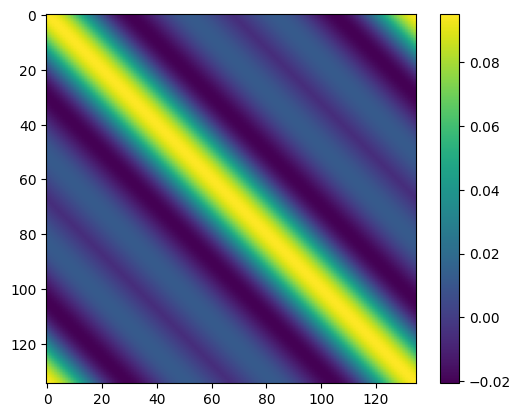

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.647132158279419 seconds
Running (alpha)=k=[0.3, 0.6]


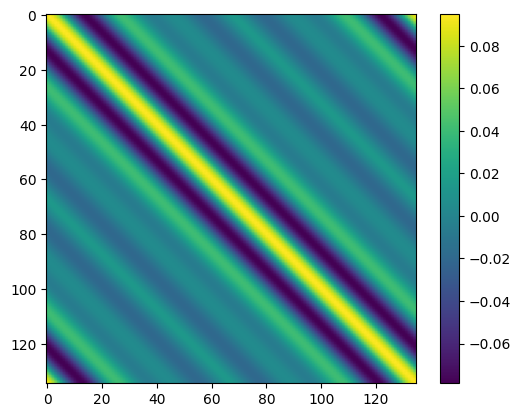

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.8463718891143799 seconds
Running (alpha)=k=[0.6, 0.8999999999999999]


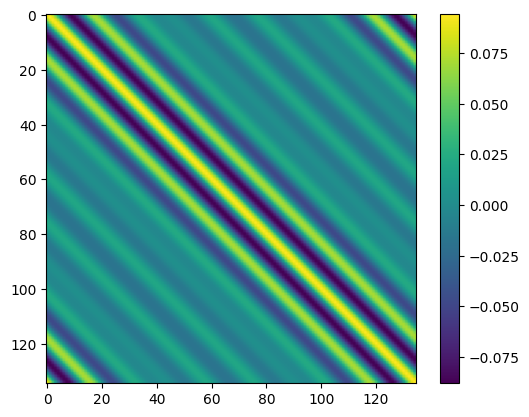

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.925356149673462 seconds
Running (alpha)=k=[0.8999999999999999, 1.2]


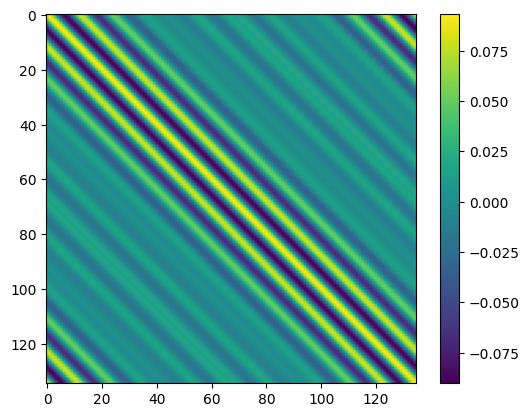

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.8531367778778076 seconds
Running (alpha)=k=[1.2, 1.5]


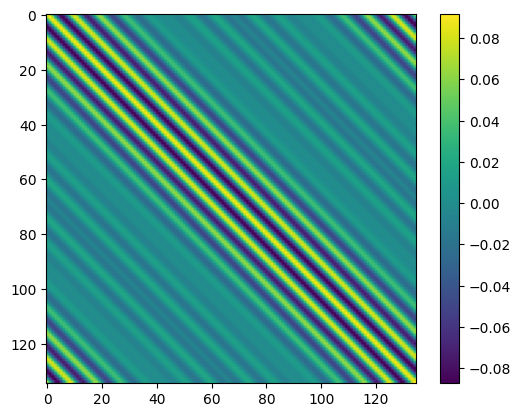

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.5590519905090332 seconds
Running (alpha)=k=[1.5, 1.7999999999999998]


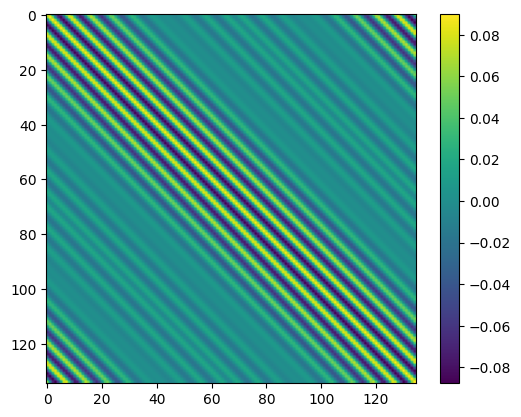

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.7127251625061035 seconds
Running (alpha)=k=[1.7999999999999998, 2.1]


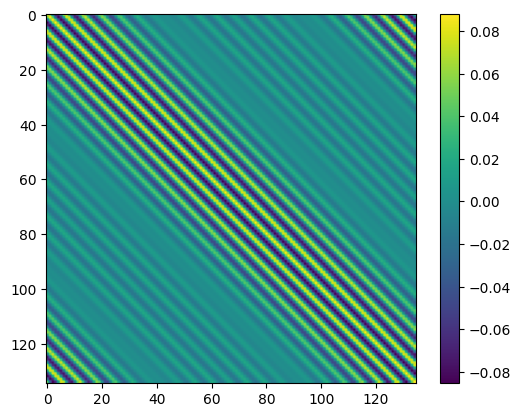

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.745016098022461 seconds
Running (alpha)=k=[2.1, 2.4]


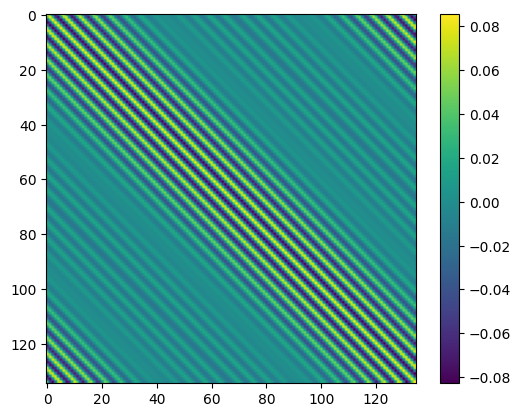

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.9077651500701904 seconds
Running (alpha)=k=[2.4, 2.6999999999999997]


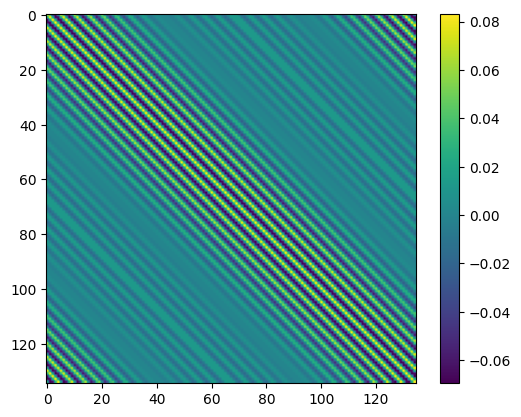

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.6090779304504395 seconds
Running (alpha)=k=[2.6999999999999997, 3.0]


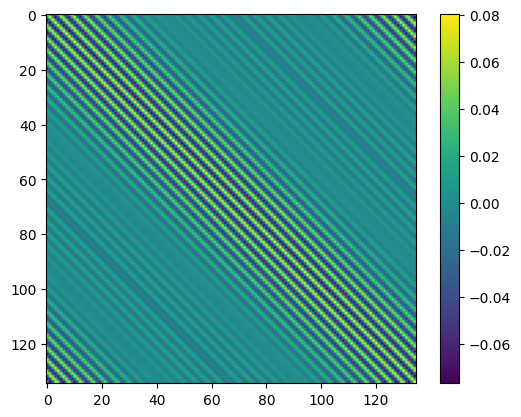

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.8122670650482178 seconds


<Figure size 640x480 with 0 Axes>

In [81]:
kbin_centers_lrg, theta_est_lrg, F_alpha_beta_lrg, Lalpha_lrg = get_P1D_est(delta_flux_b, kbin_est_lrgbins, np.zeros(C_0_invmat_binned.shape), C_0_invmat_binned)

Starting P1D.
center of kbins:  [0.0, 0.09308422677303092, 0.18616845354606185, 0.2792526803190928, 0.3723369070921237, 0.4654211338651546, 0.5585053606381856, 0.6515895874112164, 0.7446738141842474, 0.8377580409572783, 0.9308422677303092, 1.0239264945033402, 1.1170107212763711, 1.2100949480494019, 1.3031791748224328, 1.3962634015954638, 1.4893476283684948, 1.5824318551415255, 1.6755160819145567, 1.7686003086875874, 1.8616845354606184, 1.9547687622336496, 2.0478529890066803, 2.140937215779711, 2.2340214425527423, 2.327105669325773, 2.4201898960988038, 2.513274122871835, 2.6063583496448657, 2.699442576417897, 2.7925268031909276, 2.8856110299639584, 2.9786952567369895]
Getting derivative matrices.
Starting loop through data.
Running (alpha)=k=[-0.04654211338651546, 0.04654211338651546]


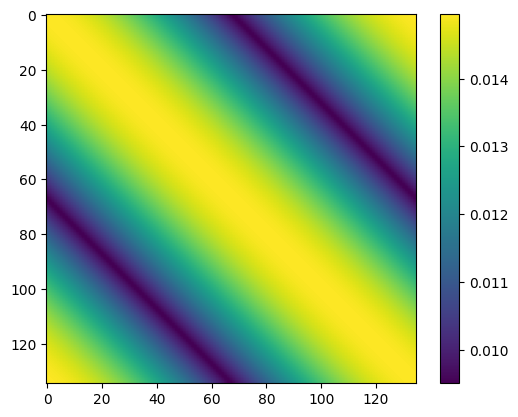

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.9263691902160645 seconds
Running (alpha)=k=[0.04654211338651546, 0.1396263401595464]


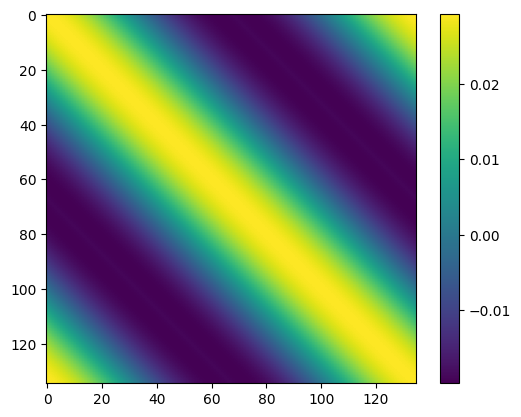

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.1489758491516113 seconds
Running (alpha)=k=[0.1396263401595464, 0.2327105669325773]


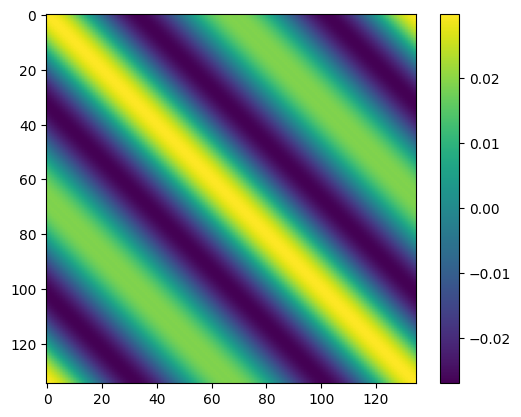

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.3561391830444336 seconds
Running (alpha)=k=[0.23271056693257733, 0.32579479370560827]


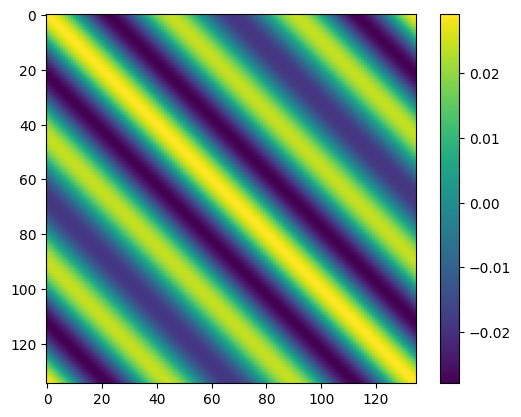

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.147926092147827 seconds
Running (alpha)=k=[0.3257947937056082, 0.4188790204786392]


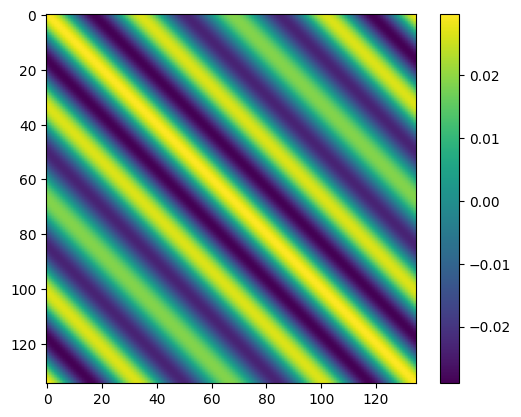

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.6695690155029297 seconds
Running (alpha)=k=[0.4188790204786391, 0.5119632472516701]


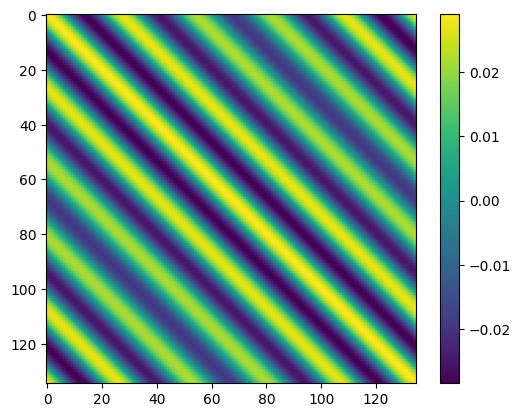

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.9670522212982178 seconds
Running (alpha)=k=[0.5119632472516701, 0.605047474024701]


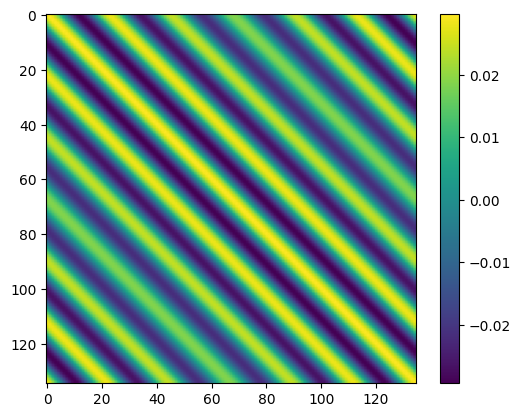

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.9140338897705078 seconds
Running (alpha)=k=[0.6050474740247009, 0.6981317007977319]


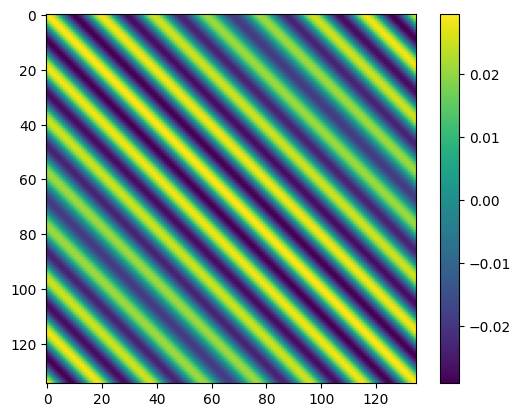

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.8250820636749268 seconds
Running (alpha)=k=[0.6981317007977319, 0.7912159275707629]


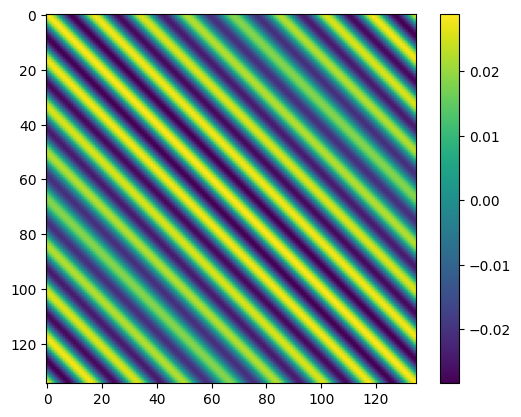

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.803554058074951 seconds
Running (alpha)=k=[0.7912159275707629, 0.8843001543437938]


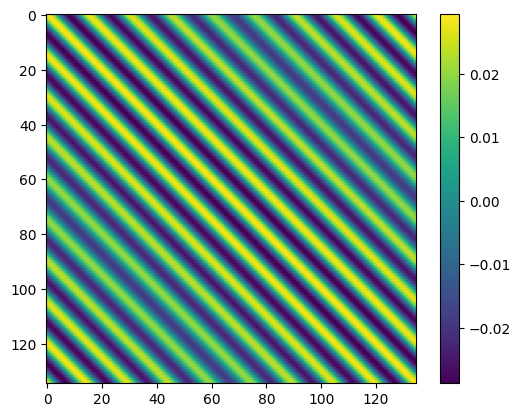

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.9085428714752197 seconds
Running (alpha)=k=[0.8843001543437937, 0.9773843811168247]


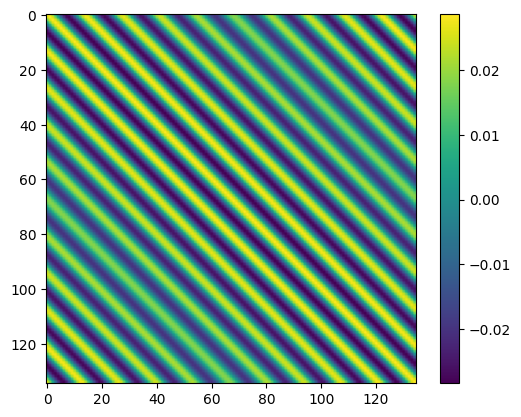

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.9127750396728516 seconds
Running (alpha)=k=[0.9773843811168247, 1.0704686078898555]


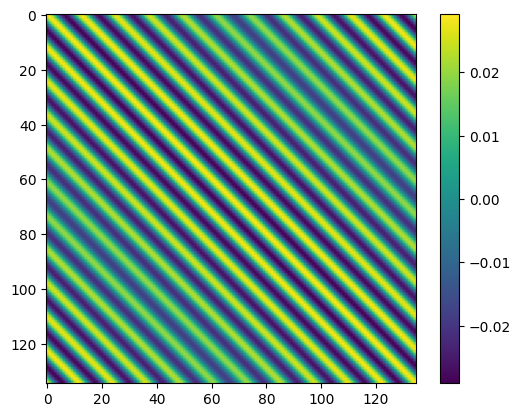

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.7089042663574219 seconds
Running (alpha)=k=[1.0704686078898558, 1.1635528346628865]


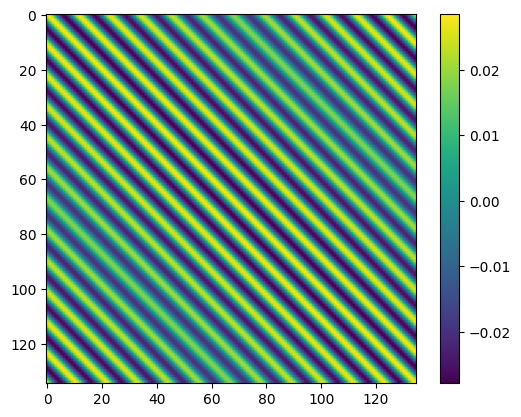

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.9588139057159424 seconds
Running (alpha)=k=[1.1635528346628865, 1.2566370614359172]


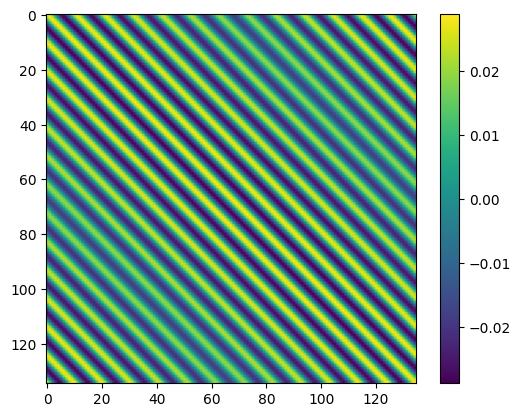

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.9697301387786865 seconds
Running (alpha)=k=[1.2566370614359175, 1.3497212882089482]


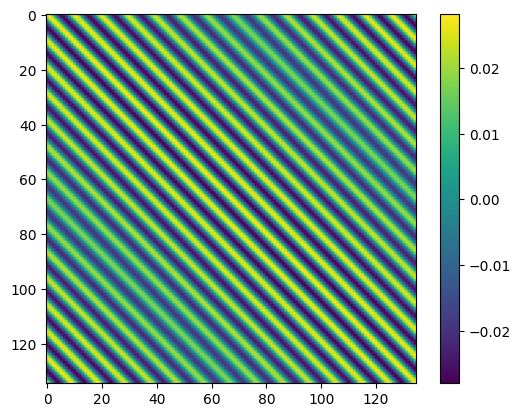

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.8186419010162354 seconds
Running (alpha)=k=[1.3497212882089484, 1.4428055149819792]


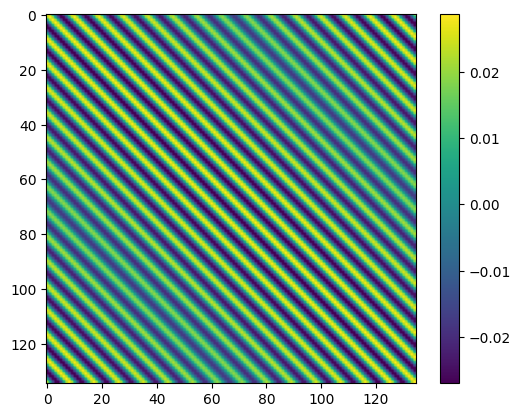

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.826181173324585 seconds
Running (alpha)=k=[1.4428055149819794, 1.5358897417550101]


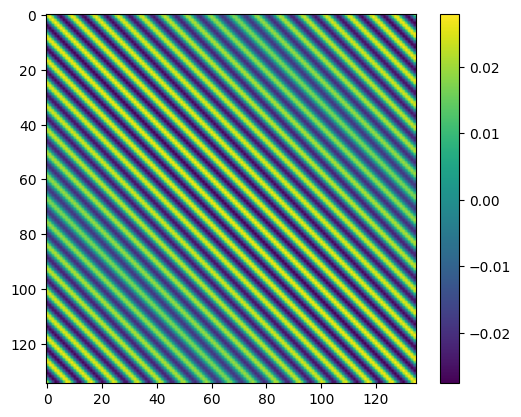

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.817234992980957 seconds
Running (alpha)=k=[1.5358897417550101, 1.6289739685280409]


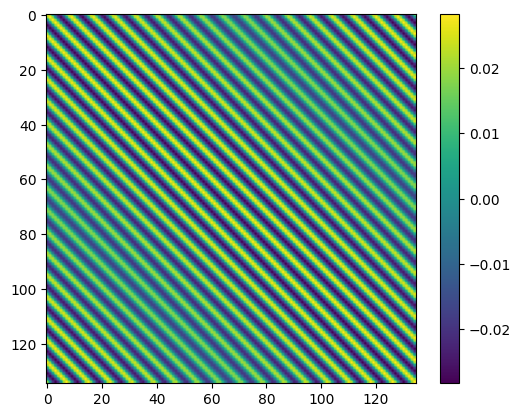

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.016658067703247 seconds
Running (alpha)=k=[1.6289739685280413, 1.722058195301072]


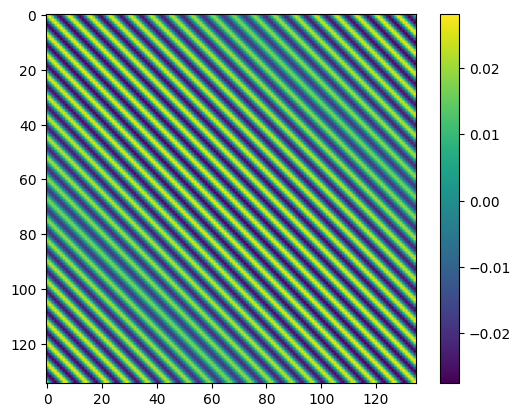

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.9259121417999268 seconds
Running (alpha)=k=[1.722058195301072, 1.8151424220741028]


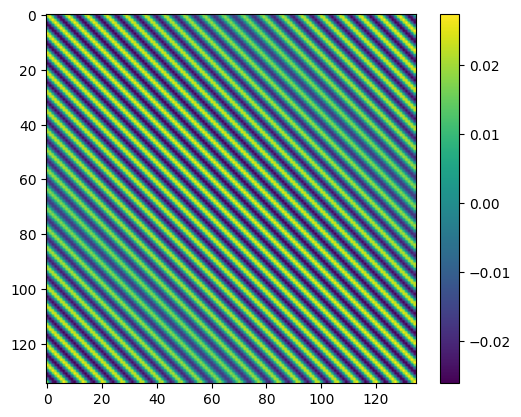

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.9533801078796387 seconds
Running (alpha)=k=[1.815142422074103, 1.9082266488471338]


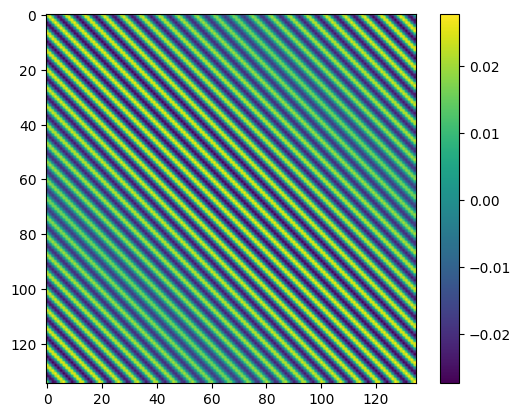

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.4363749027252197 seconds
Running (alpha)=k=[1.908226648847134, 2.001310875620165]


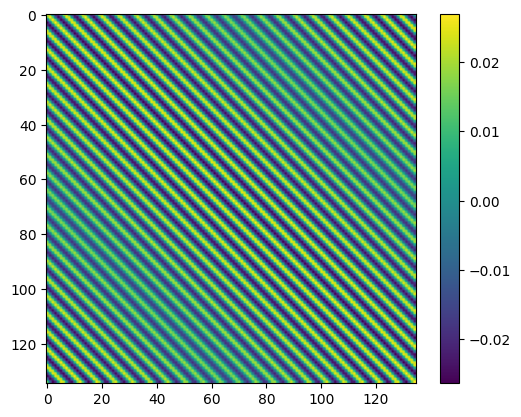

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.4515509605407715 seconds
Running (alpha)=k=[2.001310875620165, 2.0943951023931957]


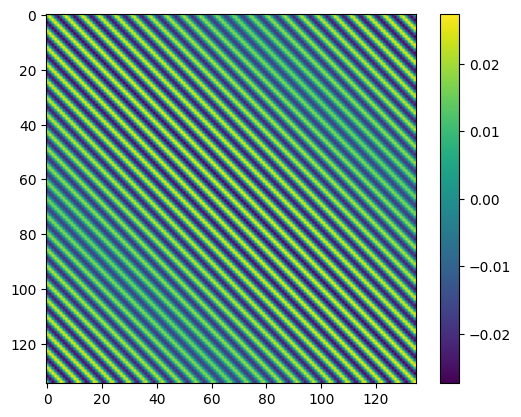

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.850322961807251 seconds
Running (alpha)=k=[2.0943951023931957, 2.1874793291662264]


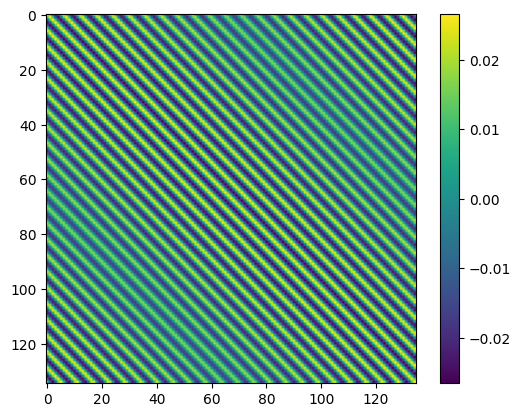

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.9646580219268799 seconds
Running (alpha)=k=[2.187479329166227, 2.2805635559392576]


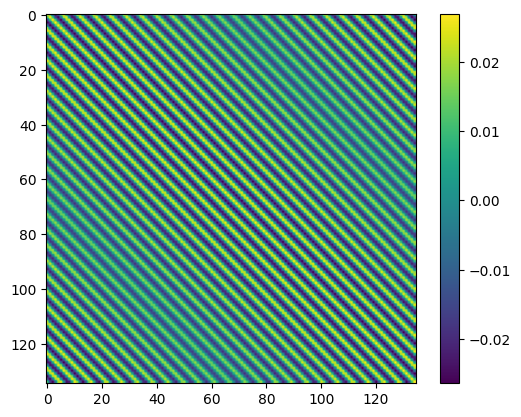

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.9994959831237793 seconds
Running (alpha)=k=[2.2805635559392576, 2.3736477827122884]


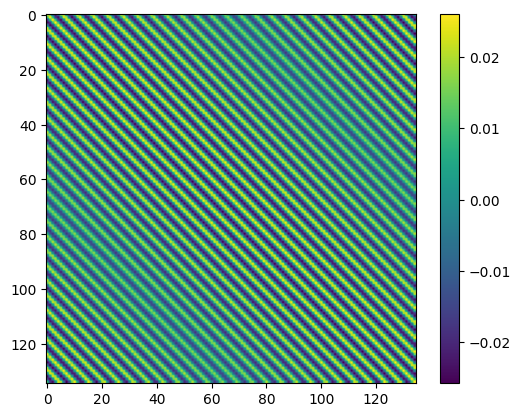

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.077315092086792 seconds
Running (alpha)=k=[2.3736477827122884, 2.466732009485319]


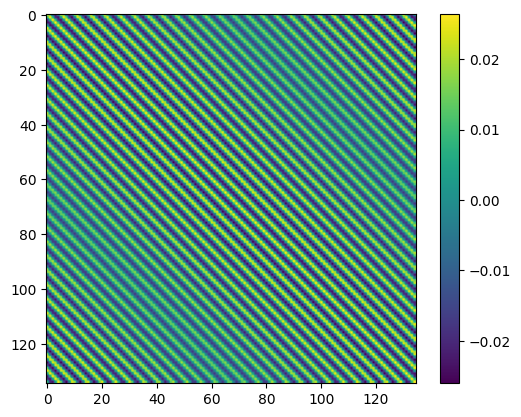

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.129249095916748 seconds
Running (alpha)=k=[2.4667320094853196, 2.5598162362583503]


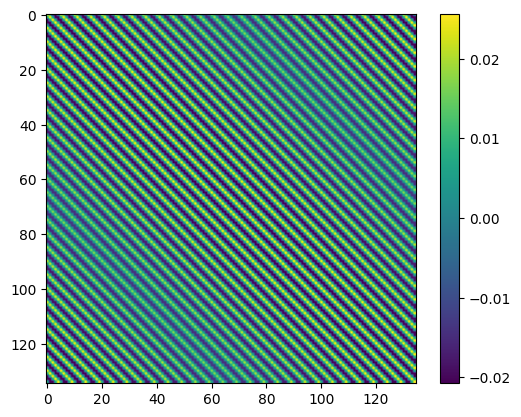

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.8639061450958252 seconds
Running (alpha)=k=[2.5598162362583503, 2.652900463031381]


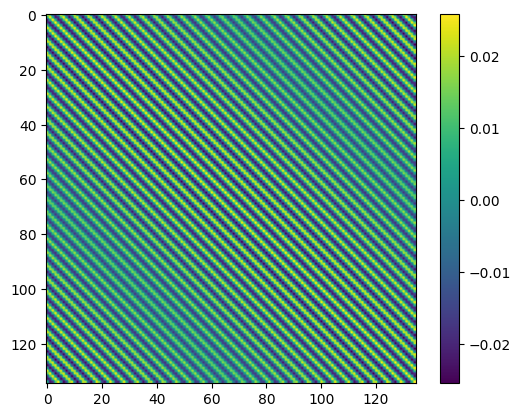

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.0565319061279297 seconds
Running (alpha)=k=[2.6529004630313815, 2.7459846898044122]


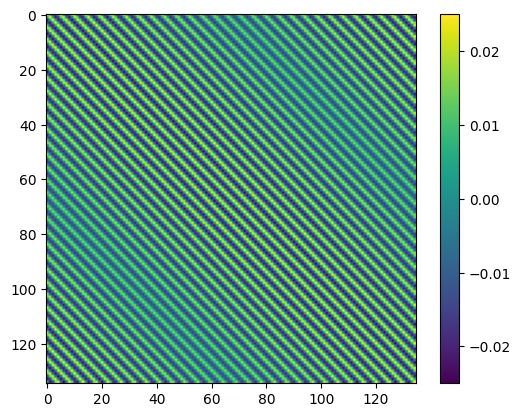

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.8182401657104492 seconds
Running (alpha)=k=[2.7459846898044122, 2.839068916577443]


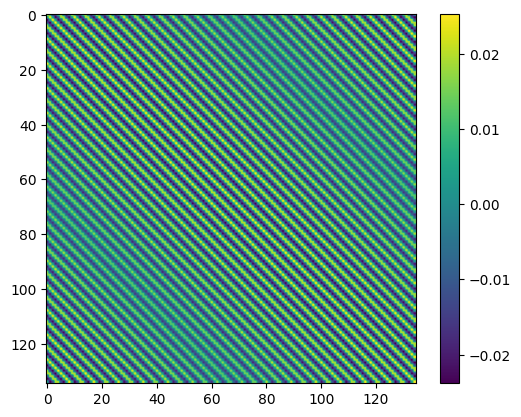

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 1.913989782333374 seconds
Running (alpha)=k=[2.839068916577443, 2.9321531433504737]


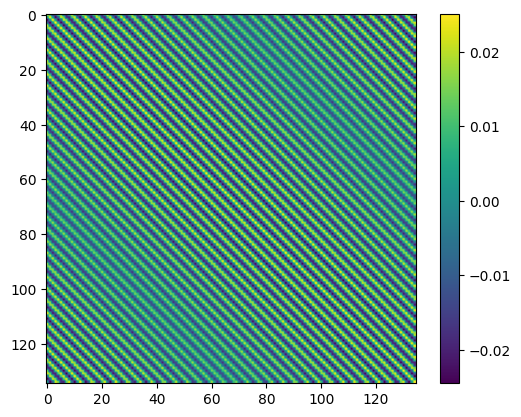

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.386483907699585 seconds
Running (alpha)=k=[2.932153143350474, 3.025237370123505]


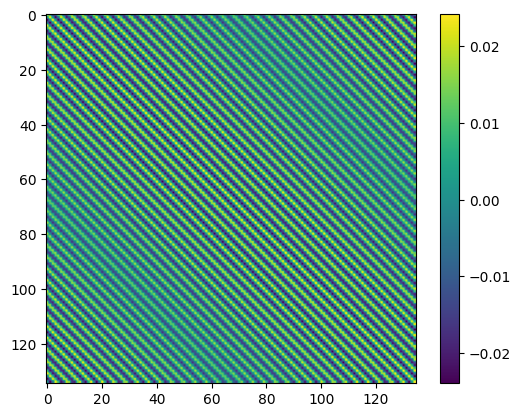

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.475921869277954 seconds


<Figure size 640x480 with 0 Axes>

In [92]:
kbin_centers, theta_est, F_alpha_beta, Lalpha = get_P1D_est(delta_flux_b, kbin_est_midbins[:33], np.zeros(C_0_invmat_binned.shape), C_0_invmat_binned)

In [106]:
kbin_small_edges = np.linspace(0, 3, 60)
kbin_est_smallbins = [[kbin_small_edges[i], kbin_small_edges[i+1]] for i in range(59)]

In [113]:
kbin_est_smallbins

[[0.0, 0.05084745762711865],
 [0.05084745762711865, 0.1016949152542373],
 [0.1016949152542373, 0.15254237288135594],
 [0.15254237288135594, 0.2033898305084746],
 [0.2033898305084746, 0.2542372881355932],
 [0.2542372881355932, 0.3050847457627119],
 [0.3050847457627119, 0.35593220338983056],
 [0.35593220338983056, 0.4067796610169492],
 [0.4067796610169492, 0.4576271186440678],
 [0.4576271186440678, 0.5084745762711864],
 [0.5084745762711864, 0.5593220338983051],
 [0.5593220338983051, 0.6101694915254238],
 [0.6101694915254238, 0.6610169491525424],
 [0.6610169491525424, 0.7118644067796611],
 [0.7118644067796611, 0.7627118644067797],
 [0.7627118644067797, 0.8135593220338984],
 [0.8135593220338984, 0.864406779661017],
 [0.864406779661017, 0.9152542372881356],
 [0.9152542372881356, 0.9661016949152543],
 [0.9661016949152543, 1.0169491525423728],
 [1.0169491525423728, 1.0677966101694916],
 [1.0677966101694916, 1.1186440677966103],
 [1.1186440677966103, 1.1694915254237288],
 [1.1694915254237288, 

Starting P1D.
center of kbins:  [0.025423728813559324, 0.07627118644067797, 0.1271186440677966, 0.17796610169491528, 0.2288135593220339, 0.2796610169491526, 0.3305084745762712, 0.38135593220338987, 0.4322033898305085, 0.4830508474576271, 0.5338983050847458, 0.5847457627118644, 0.6355932203389831, 0.6864406779661018, 0.7372881355932204, 0.7881355932203391, 0.8389830508474576, 0.8898305084745763, 0.940677966101695, 0.9915254237288136, 1.042372881355932, 1.093220338983051, 1.1440677966101696, 1.194915254237288, 1.245762711864407, 1.2966101694915255, 1.347457627118644, 1.398305084745763, 1.4491525423728815, 1.5, 1.5508474576271187, 1.6016949152542375, 1.652542372881356, 1.7033898305084747, 1.7542372881355934, 1.805084745762712, 1.8559322033898304, 1.9067796610169494, 1.957627118644068, 2.0084745762711864, 2.0593220338983054, 2.110169491525424, 2.1610169491525424, 2.211864406779661, 2.26271186440678, 2.3135593220338984, 2.3644067796610173, 2.415254237288136, 2.4661016949152543, 2.5169491525

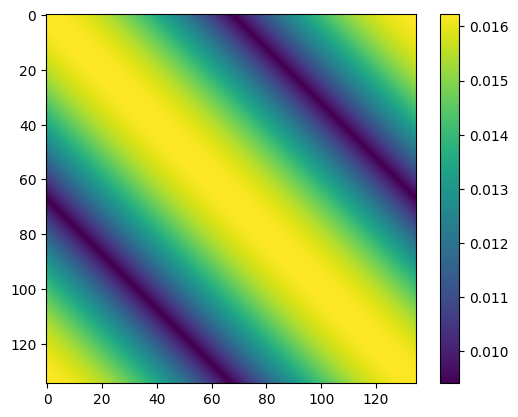

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.58573317527771 seconds
Running (alpha)=k=[0.05084745762711865, 0.1016949152542373]


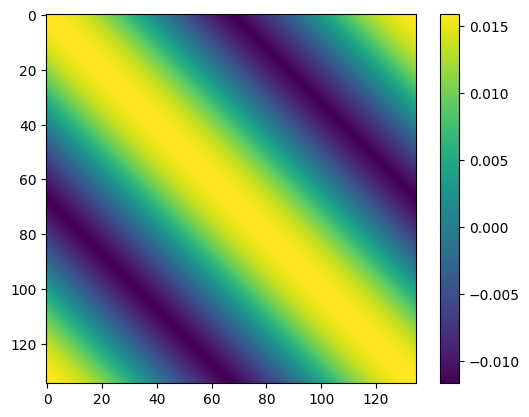

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.249598979949951 seconds
Running (alpha)=k=[0.1016949152542373, 0.15254237288135594]


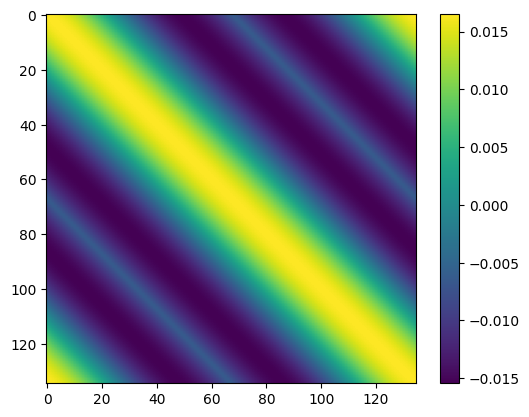

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.416612148284912 seconds
Running (alpha)=k=[0.15254237288135594, 0.2033898305084746]


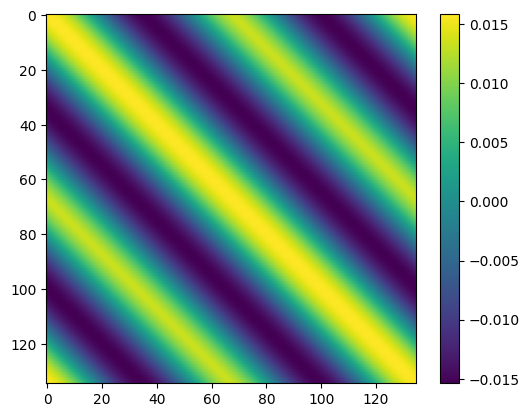

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.5624659061431885 seconds
Running (alpha)=k=[0.2033898305084746, 0.2542372881355932]


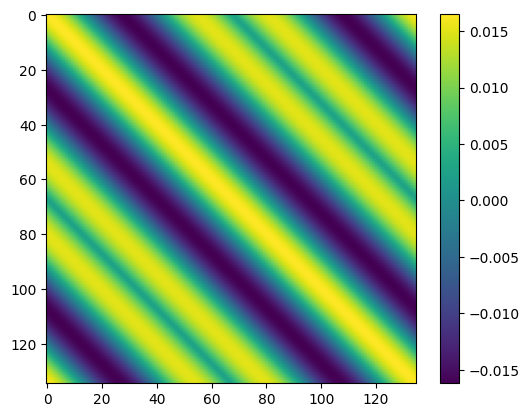

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.288599967956543 seconds
Running (alpha)=k=[0.2542372881355932, 0.3050847457627119]


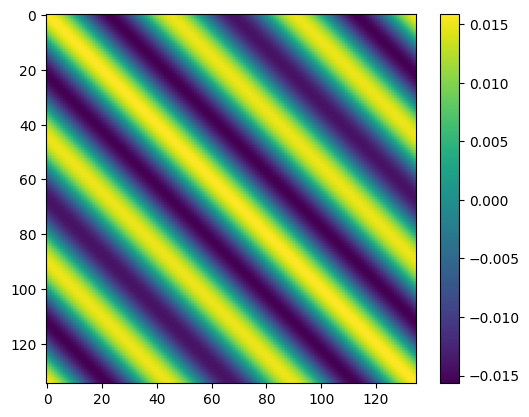

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.1939237117767334 seconds
Running (alpha)=k=[0.3050847457627119, 0.35593220338983056]


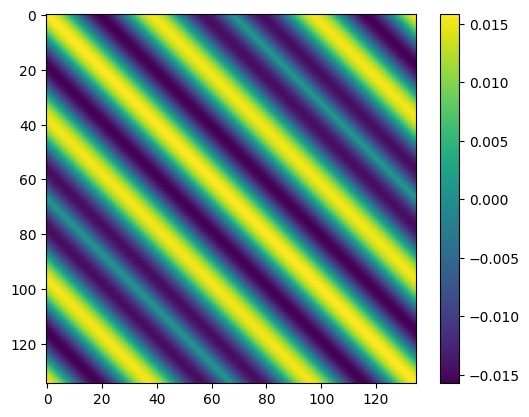

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.1781909465789795 seconds
Running (alpha)=k=[0.35593220338983056, 0.4067796610169492]


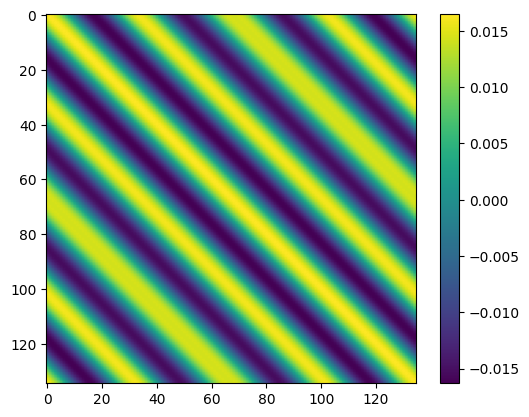

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.255753993988037 seconds
Running (alpha)=k=[0.4067796610169492, 0.4576271186440678]


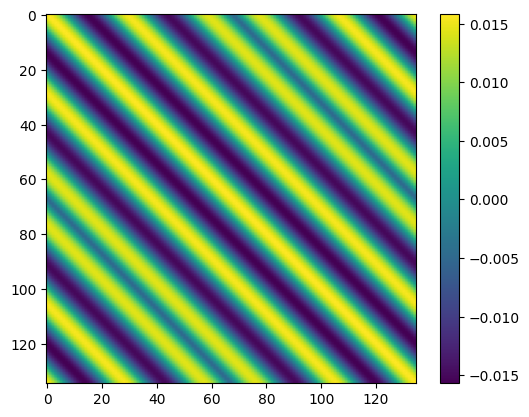

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.35715913772583 seconds
Running (alpha)=k=[0.4576271186440678, 0.5084745762711864]


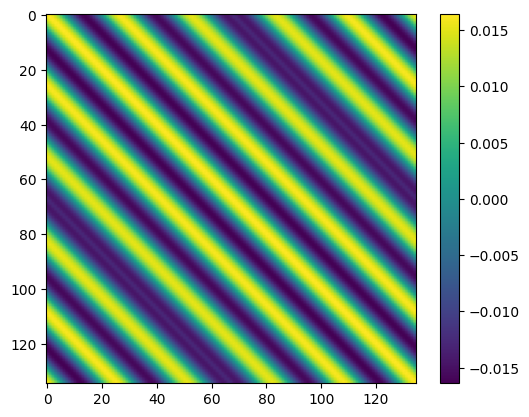

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.310777187347412 seconds
Running (alpha)=k=[0.5084745762711864, 0.5593220338983051]


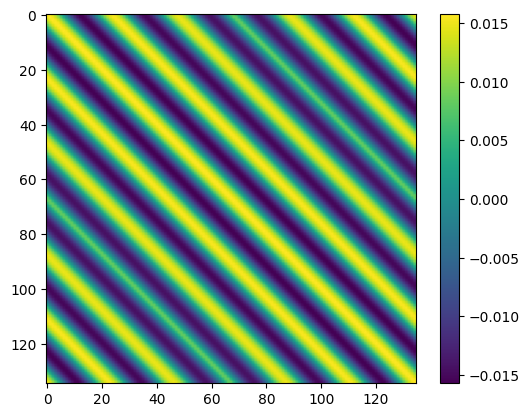

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.444124221801758 seconds
Running (alpha)=k=[0.5593220338983051, 0.6101694915254238]


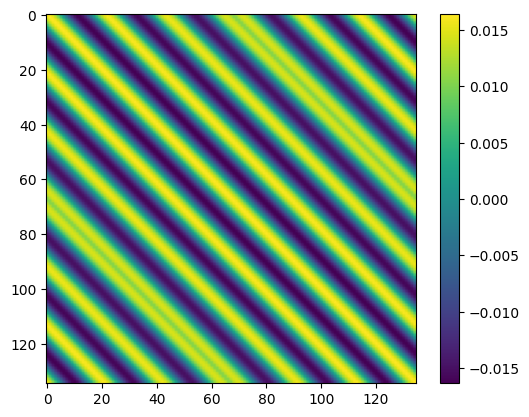

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.2770628929138184 seconds
Running (alpha)=k=[0.6101694915254238, 0.6610169491525424]


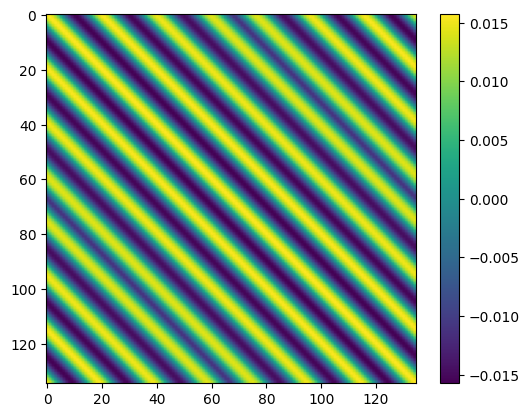

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.3666160106658936 seconds
Running (alpha)=k=[0.6610169491525424, 0.7118644067796611]


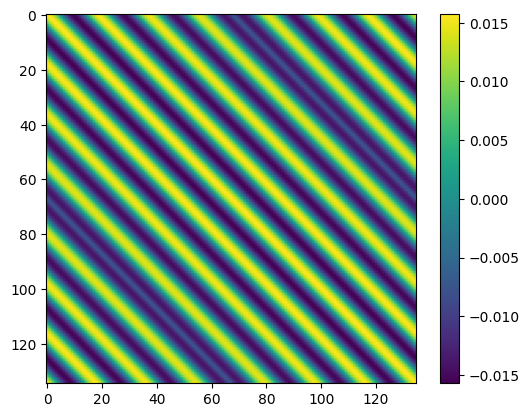

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.3625378608703613 seconds
Running (alpha)=k=[0.7118644067796611, 0.7627118644067797]


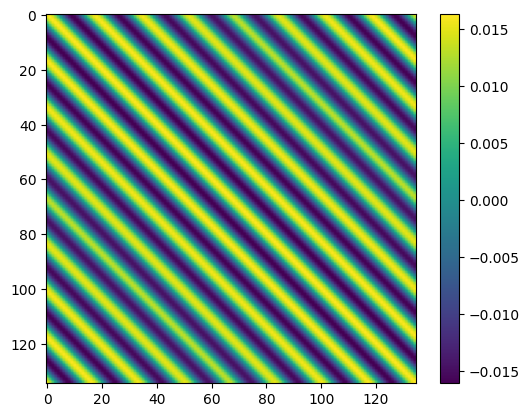

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.2779691219329834 seconds
Running (alpha)=k=[0.7627118644067797, 0.8135593220338984]


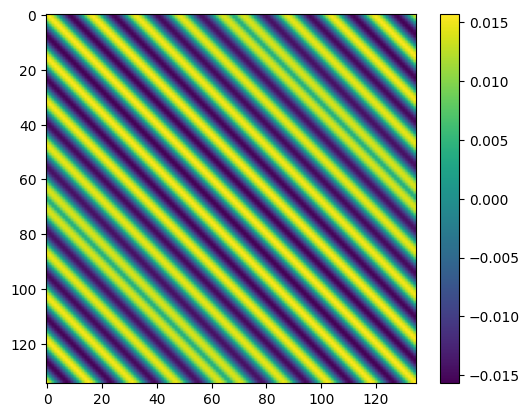

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.582412004470825 seconds
Running (alpha)=k=[0.8135593220338984, 0.864406779661017]


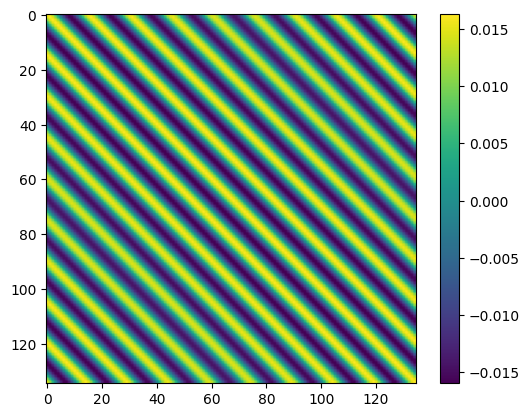

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.620713949203491 seconds
Running (alpha)=k=[0.864406779661017, 0.9152542372881356]


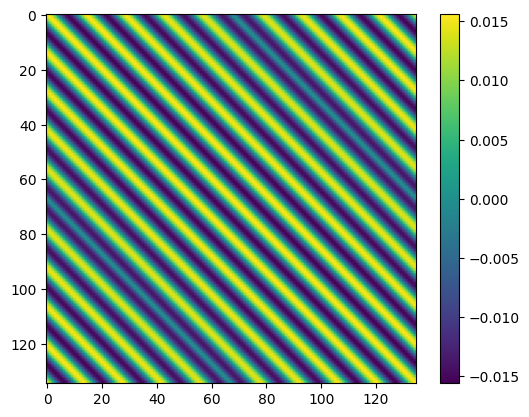

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 4.60137414932251 seconds
Running (alpha)=k=[0.9152542372881356, 0.9661016949152543]


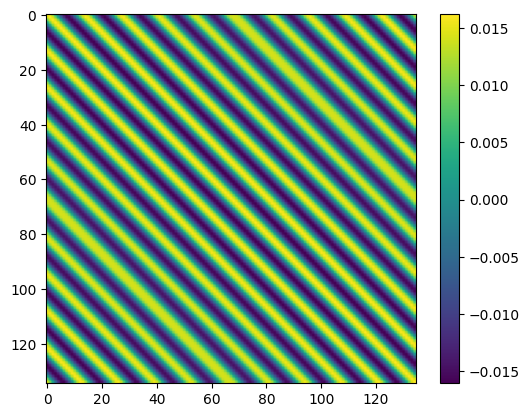

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 4.613301992416382 seconds
Running (alpha)=k=[0.9661016949152543, 1.0169491525423728]


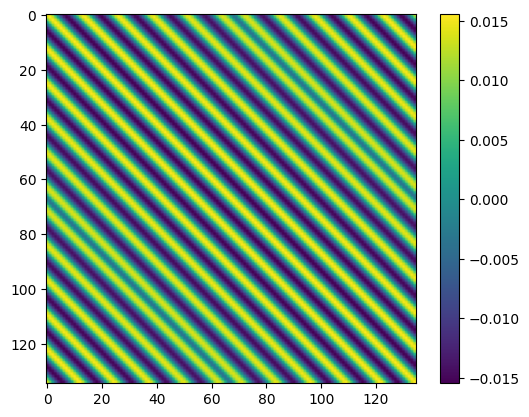

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.657144069671631 seconds
Running (alpha)=k=[1.0169491525423728, 1.0677966101694916]


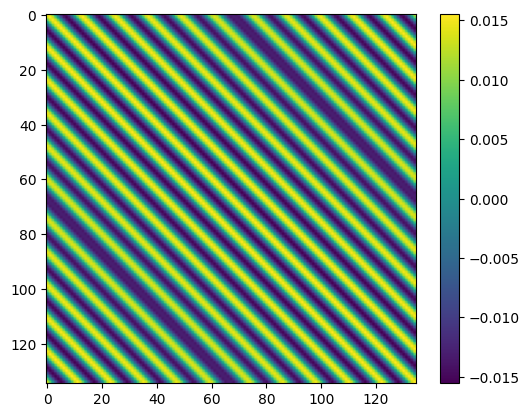

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.2813332080841064 seconds
Running (alpha)=k=[1.0677966101694916, 1.1186440677966103]


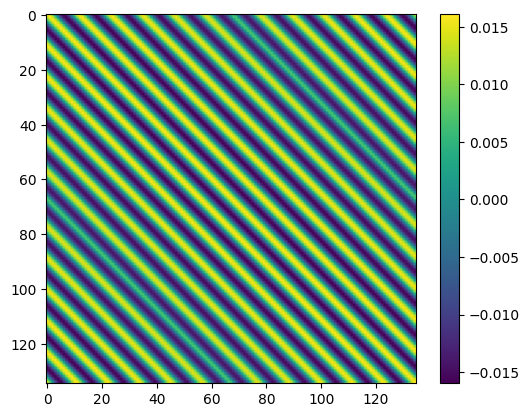

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.4887170791625977 seconds
Running (alpha)=k=[1.1186440677966103, 1.1694915254237288]


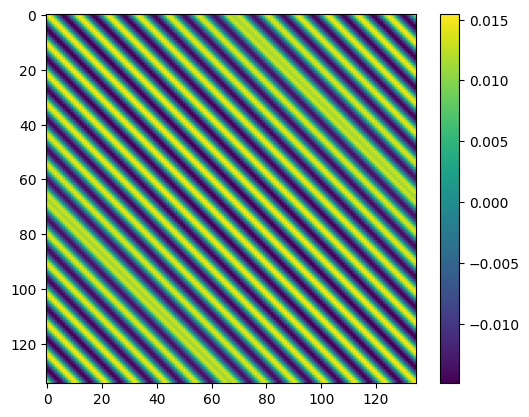

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.8179259300231934 seconds
Running (alpha)=k=[1.1694915254237288, 1.2203389830508475]


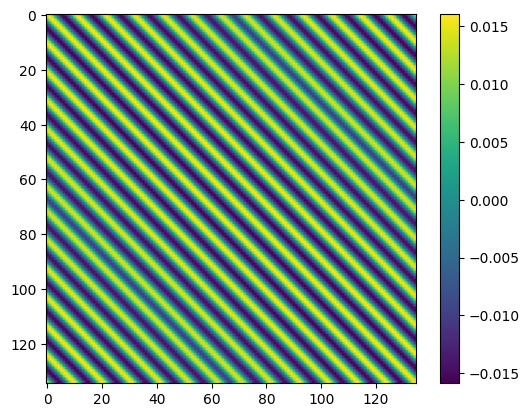

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.134617805480957 seconds
Running (alpha)=k=[1.2203389830508475, 1.2711864406779663]


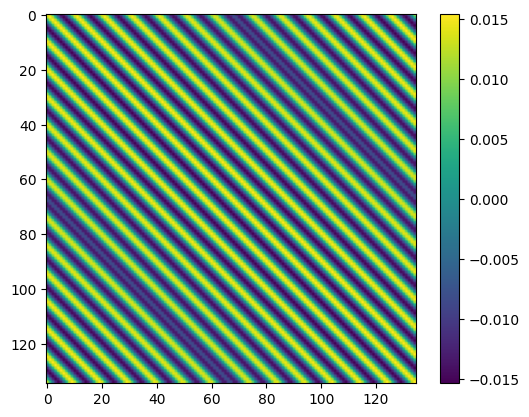

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.61092209815979 seconds
Running (alpha)=k=[1.2711864406779663, 1.3220338983050848]


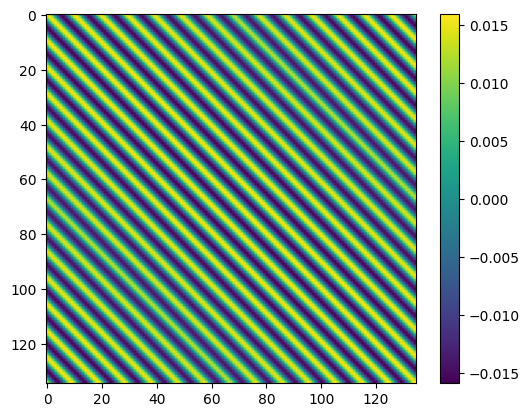

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.1524341106414795 seconds
Running (alpha)=k=[1.3220338983050848, 1.3728813559322035]


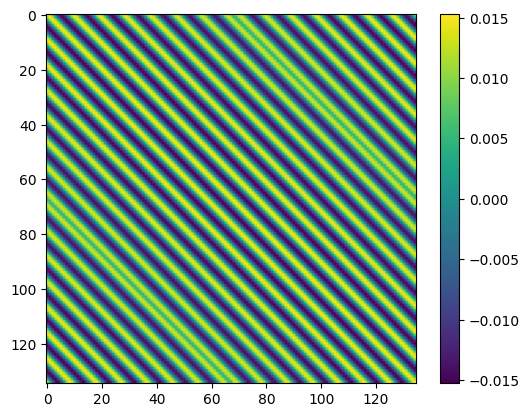

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.7215421199798584 seconds
Running (alpha)=k=[1.3728813559322035, 1.4237288135593222]


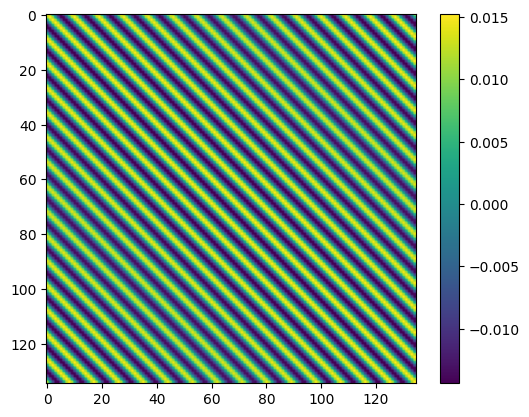

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.1090290546417236 seconds
Running (alpha)=k=[1.4237288135593222, 1.4745762711864407]


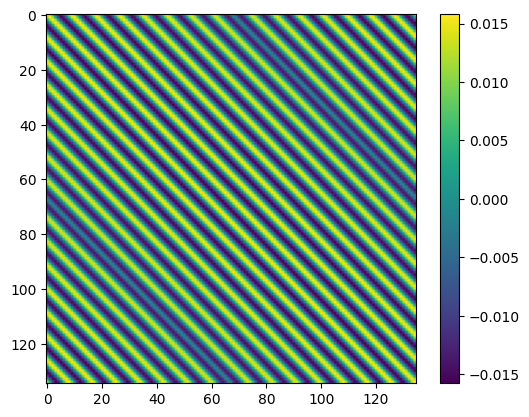

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.977248191833496 seconds
Running (alpha)=k=[1.4745762711864407, 1.5254237288135595]


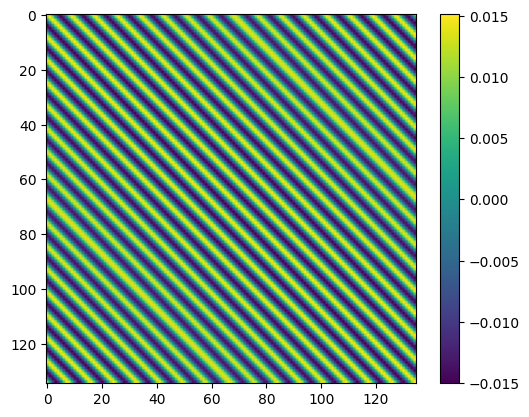

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.7100069522857666 seconds
Running (alpha)=k=[1.5254237288135595, 1.576271186440678]


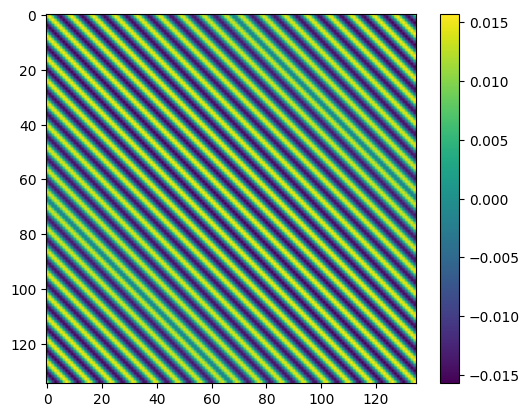

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.010510206222534 seconds
Running (alpha)=k=[1.576271186440678, 1.6271186440677967]


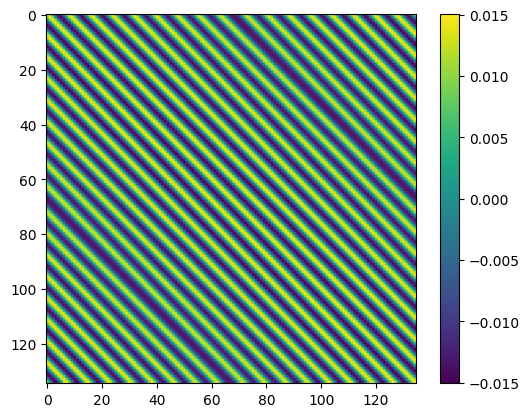

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 4.055398225784302 seconds
Running (alpha)=k=[1.6271186440677967, 1.6779661016949154]


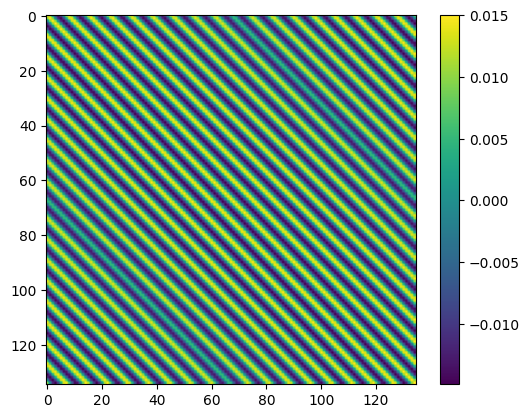

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.458280086517334 seconds
Running (alpha)=k=[1.6779661016949154, 1.728813559322034]


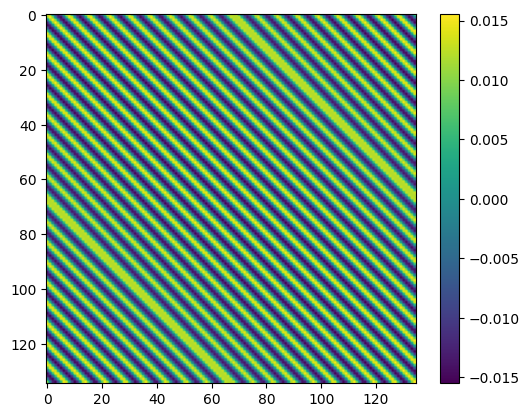

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.620755195617676 seconds
Running (alpha)=k=[1.728813559322034, 1.7796610169491527]


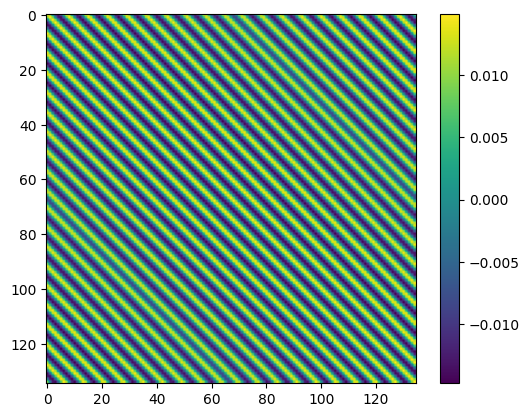

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.1208648681640625 seconds
Running (alpha)=k=[1.7796610169491527, 1.8305084745762712]


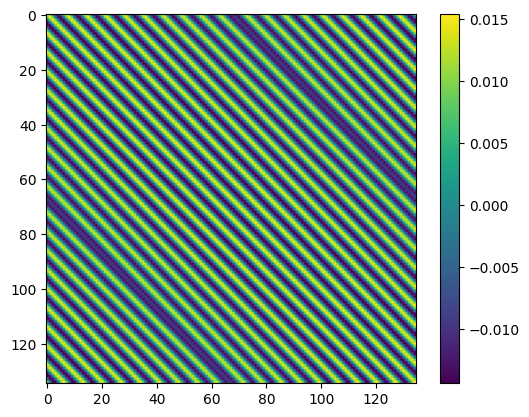

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.5420689582824707 seconds
Running (alpha)=k=[1.8305084745762712, 1.88135593220339]


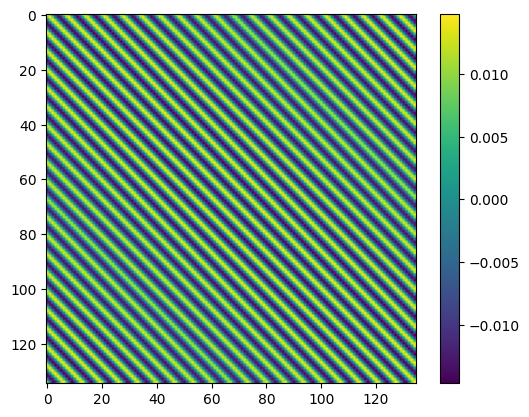

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.8861029148101807 seconds
Running (alpha)=k=[1.88135593220339, 1.9322033898305087]


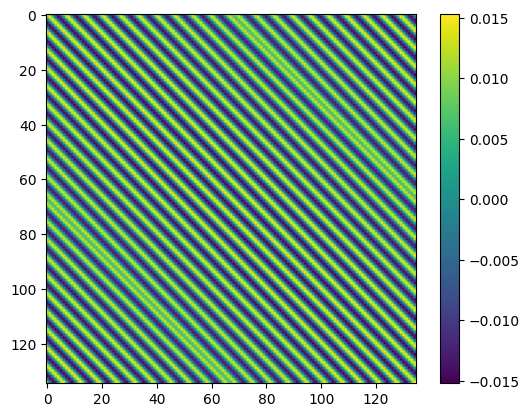

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.6793758869171143 seconds
Running (alpha)=k=[1.9322033898305087, 1.9830508474576272]


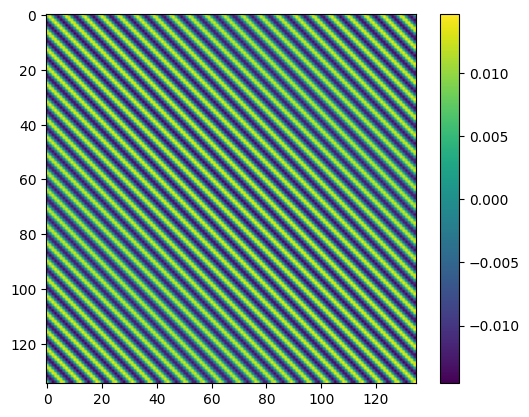

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.8586771488189697 seconds
Running (alpha)=k=[1.9830508474576272, 2.0338983050847457]


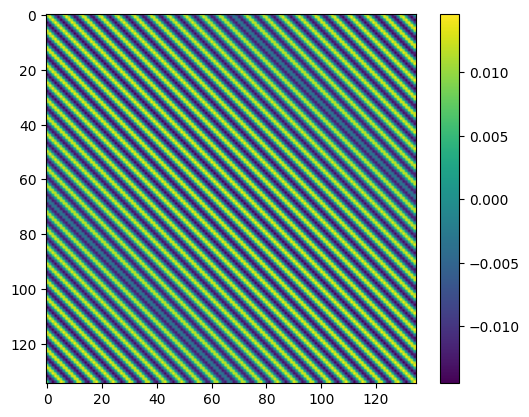

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.751236915588379 seconds
Running (alpha)=k=[2.0338983050847457, 2.0847457627118646]


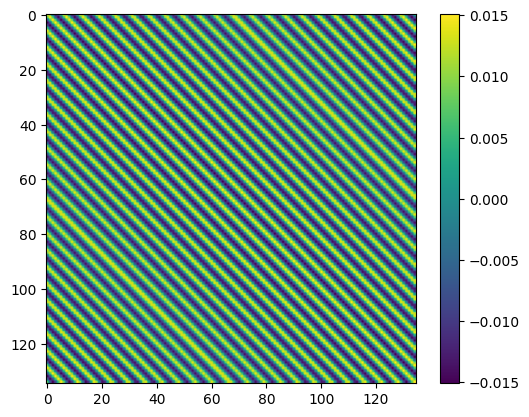

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.5122270584106445 seconds
Running (alpha)=k=[2.0847457627118646, 2.135593220338983]


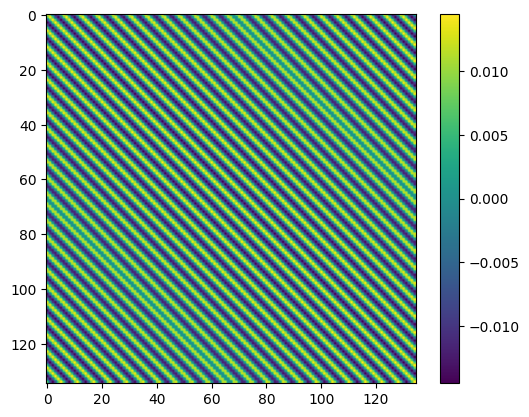

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.3212738037109375 seconds
Running (alpha)=k=[2.135593220338983, 2.1864406779661016]


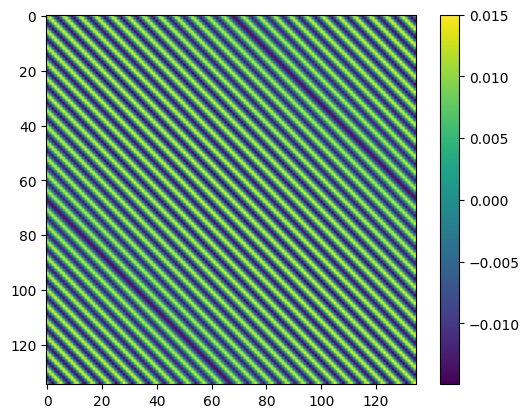

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.2840771675109863 seconds
Running (alpha)=k=[2.1864406779661016, 2.2372881355932206]


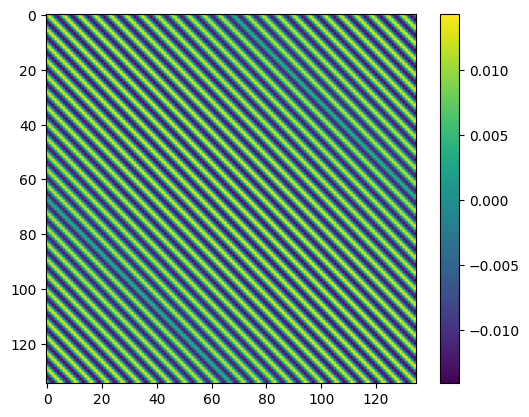

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.124537944793701 seconds
Running (alpha)=k=[2.2372881355932206, 2.288135593220339]


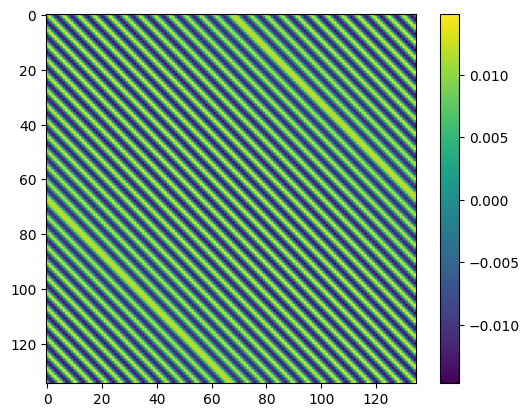

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.865245819091797 seconds
Running (alpha)=k=[2.288135593220339, 2.3389830508474576]


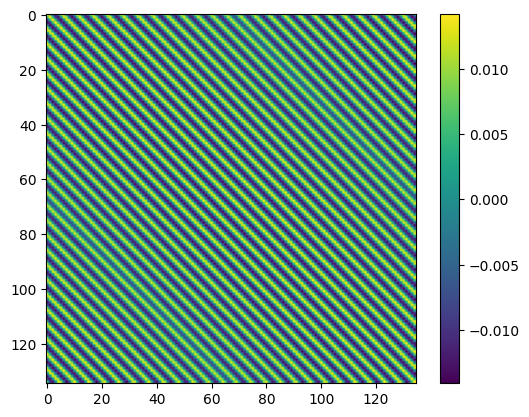

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.1413588523864746 seconds
Running (alpha)=k=[2.3389830508474576, 2.3898305084745766]


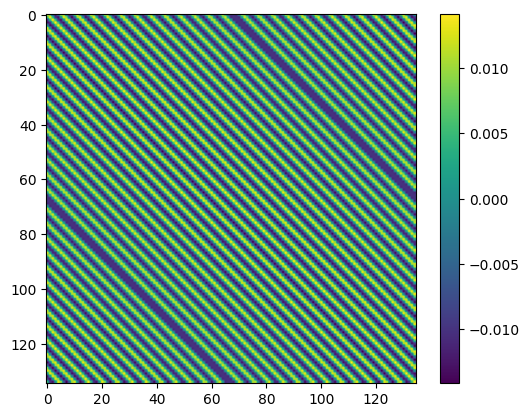

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.891392946243286 seconds
Running (alpha)=k=[2.3898305084745766, 2.440677966101695]


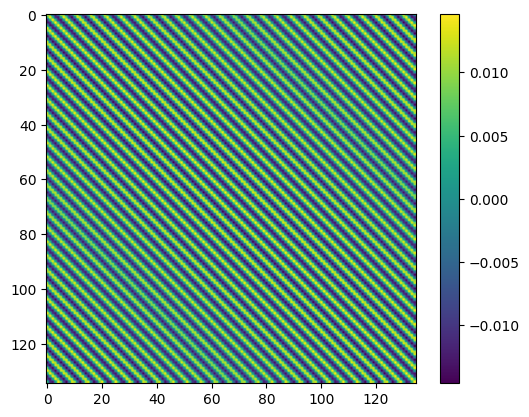

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.044128179550171 seconds
Running (alpha)=k=[2.440677966101695, 2.4915254237288136]


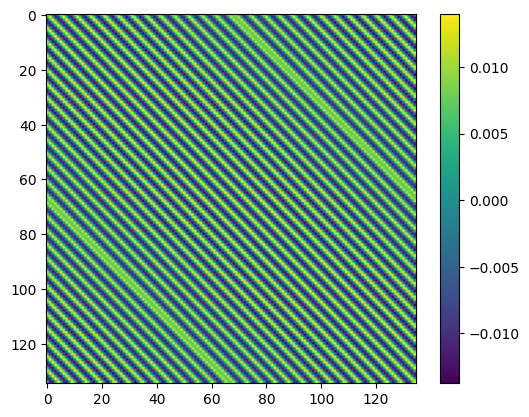

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.841776132583618 seconds
Running (alpha)=k=[2.4915254237288136, 2.5423728813559325]


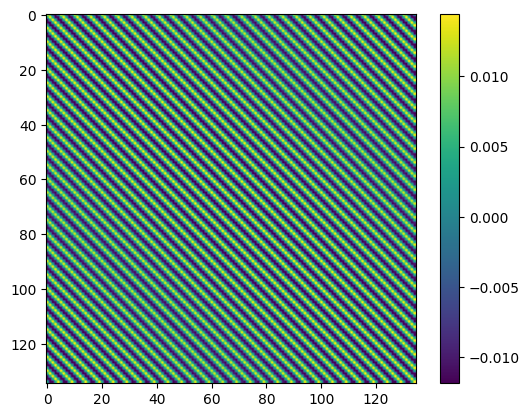

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.955502986907959 seconds
Running (alpha)=k=[2.5423728813559325, 2.593220338983051]


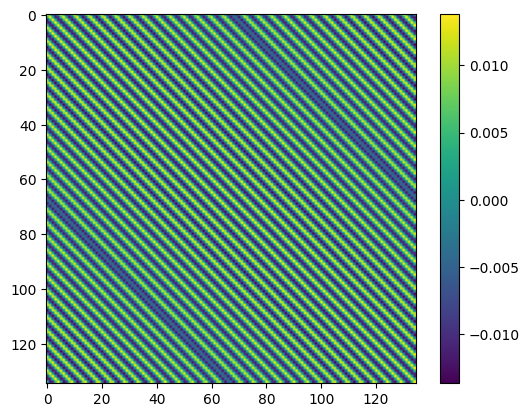

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.477625846862793 seconds
Running (alpha)=k=[2.593220338983051, 2.6440677966101696]


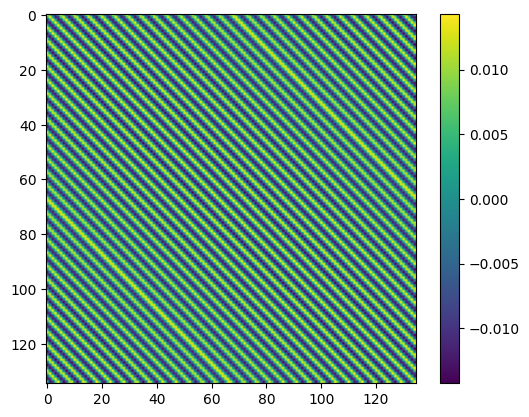

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.9000556468963623 seconds
Running (alpha)=k=[2.6440677966101696, 2.6949152542372885]


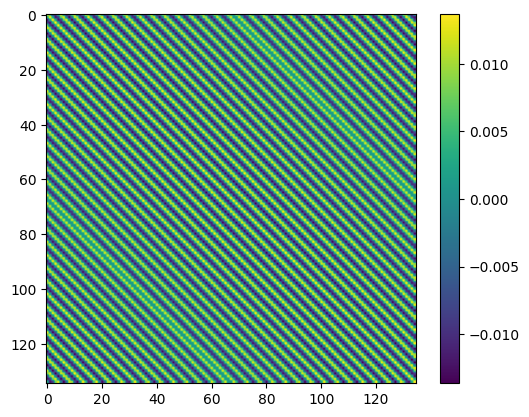

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.5965240001678467 seconds
Running (alpha)=k=[2.6949152542372885, 2.745762711864407]


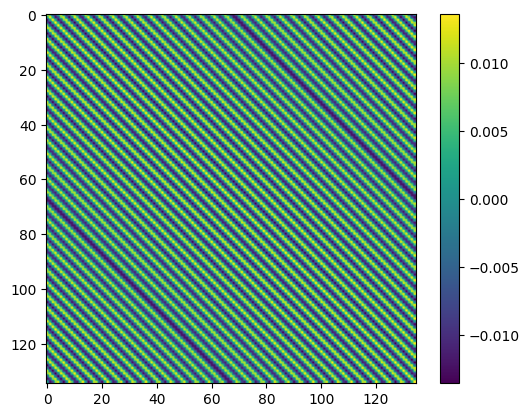

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.1973202228546143 seconds
Running (alpha)=k=[2.745762711864407, 2.7966101694915255]


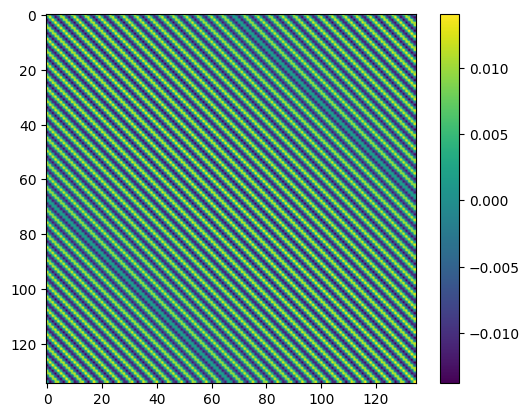

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.937666177749634 seconds
Running (alpha)=k=[2.7966101694915255, 2.8474576271186445]


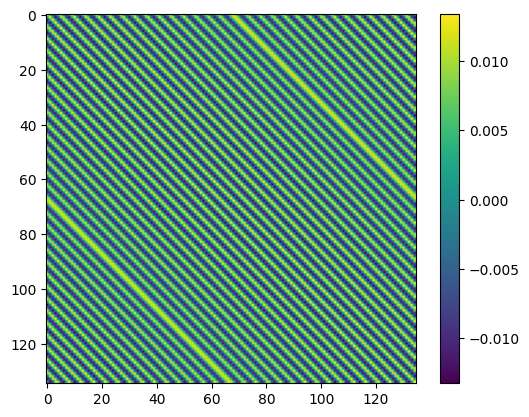

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.911233901977539 seconds
Running (alpha)=k=[2.8474576271186445, 2.898305084745763]


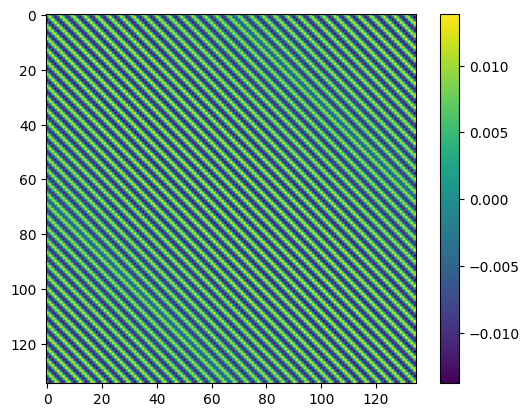

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.8423502445220947 seconds
Running (alpha)=k=[2.898305084745763, 2.9491525423728815]


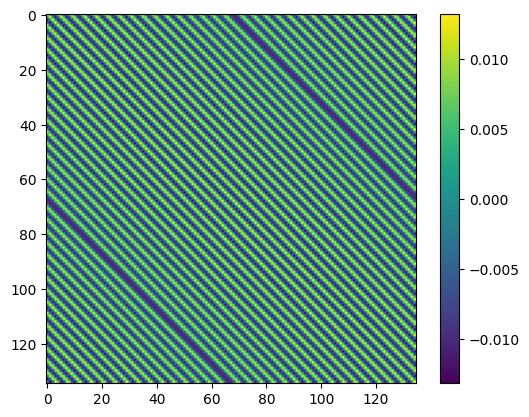

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 2.5443849563598633 seconds
Running (alpha)=k=[2.9491525423728815, 3.0]


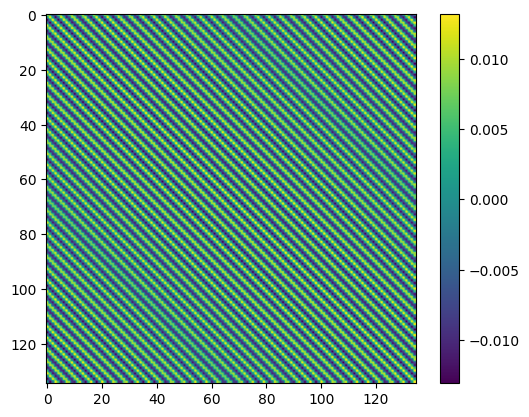

percent done: 20.0
percent done: 40.0
percent done: 60.0
percent done: 80.0
percent done: 100.0
This k took 3.2125229835510254 seconds


<Figure size 640x480 with 0 Axes>

In [108]:
kbin_centers_small, theta_est_small, F_alpha_beta_small, Lalpha_small = get_P1D_est(delta_flux_b, kbin_est_smallbins, np.zeros(C_0_invmat_binned.shape), C_0_invmat_binned)

In [663]:
# Lalpha_term1 = np.zeros(len(kpar))
# Lalpha_term2 = np.zeros(len(kpar))

# Lalpha_beta  = np.zeros((len(kpar),len(kpar)))
# # each k mode, given separation bin s, is a parameter alpha
# # for simplification let us do only P1D and one non-zero separation bin
# # here is the case for the non-zero separation bin defined earlier
# # for k in range(1,len(kpar)):
# for k in range(1,5): # our alpha
#     start = time.time()
#     print(f"Running (alpha)=k={kpar[k]}")
#     for m in range(nside):
#         for n in range(nside):
#             # for this I=[m,n] skewer, get 1 and 2 data vectors for all pairs within separation bin
#             # I = [m,n]
#             delta_I = delta_flux_grid[m,n][:, np.newaxis]
#             # print(f"Skewer I is at [{m,n}] and value {delta_I}")
#             if not np.isnan(delta_I).any():
#                 # make m and n arrays of the same length as the offsets
#                 mvec = np.full(len(m_offsets), m)
#                 nvec = np.full(len(n_offsets), n)
#                 m2lr = (mvec+m_offsets)%nside # first quadrant, periodic boundary conditions
#                 n2lr = (nvec+n_offsets)%nside
#                 m2ul = (mvec-m_offsets)%nside # second quadrant
#                 n2ul = (nvec-n_offsets)%nside
#                 # reduce all to those which are within the full grid
#                 quad1include = (m2lr<nside) & (n2lr<nside)
#                 m2lr = (m2lr[quad1include]).astype(int)
#                 n2lr = (n2lr[quad1include]).astype(int)
#                 quad2include = (m2ul<nside) & (n2ul<nside)
#                 m2ul = (m2ul[quad2include]).astype(int)
#                 n2ul = (n2ul[quad2include]).astype(int)
#                 # Check that you have pairs.
#                 quad1len = len(m2lr)
#                 quad2len = len(m2ul)
#                 tot_in_bin = quad1len+quad2len
#                 if tot_in_bin==0:
#                     sys.exit(f"Not finding any pairs for grid point {m}, {n}")
                
#                 # now loop through all the pairs J for this I skewer
#                 for c in range(len(m2lr)):
#                     delta_J = delta_flux_grid[m2lr[c],n2lr[c]] # this is quasar J at [m2lr[c],n2lr[c]] which is sep away from quasar I at [m,n]
#                     if not np.isnan(delta_J).any():
#                         delta_J = delta_J[:, np.newaxis]
#                         # get the exact separation
#                         delta_theta = np.linalg.norm(position_grid[m2lr[c],n2lr[c]]-position_grid[m,n])
#                         # get the derivative matrix from function Cij_alpha
#                         Cij_alpha_IJ = Cij_alpha(delta_I, delta_J, delta_theta, kpar, k, pix_spacing)
#                         y_I = np.matmul(C_0_invmat,delta_I)
#                         y_J = np.matmul(C_0_invmat,delta_J)
#                         Lalpha_term1[k] += np.matmul(np.matmul(y_I.T, Cij_alpha_IJ), y_J)[0][0]
#                         for kprime in range(1,5): # our beta
#                             # compute the second derivative
#                             Cij_beta_JI = Cij_alpha(delta_J, delta_I, kpar, kprime, pix_spacing)
#                             # C0_invmat is the same for I and J, since no noise in sim
#                             Lalpha_beta[k, kprime] += np.trace(np.matmul(np.matmul(np.matmul(C_0_invmat, Cij_alpha_IJ), C_0_invmat), Cij_beta_JI))
#         print(f"m={m}.")
#             # do not need to get term 2 as the second term is zero for derivatives w.r.t. non-P1D
    
#     end = time.time()
#     print(f"This k took {start-end} seconds")
# Lalpha_term1*=0.5
# # Lalpha_term2*=0.5
# Lalpha_beta*=-0.5
# L_alpha = Lalpha_term1-Lalpha_term2





# Do the P1D skewer measurements

In [59]:
# reshape delta_flux_k to be Ns x Np again
delta_flux_b_flat = np.ma.masked_array(np.reshape(delta_flux_b, (nskew, Np_b)))

# for those that aren't nan:
pk_all = []
for i in range(len(delta_flux_b_flat)):
    if not np.isnan(delta_flux_b_flat[i]).any():
        delta_flux_k = np.fft.rfft(delta_flux_b_flat[i])
        pk_all.append(abs(delta_flux_k)**2*pix_spacing_b/Np_b)
# delta_flux_k = np.fft.rfft(delta_flux_b_flat, axis=1)
# pk_all=abs(delta_flux_k)**2
pk_avg = np.average(np.array(pk_all), axis=0) # average over all skewers in this axis


Text(0.5, 1.0, 'Pixelization = 0.50 Mpc')

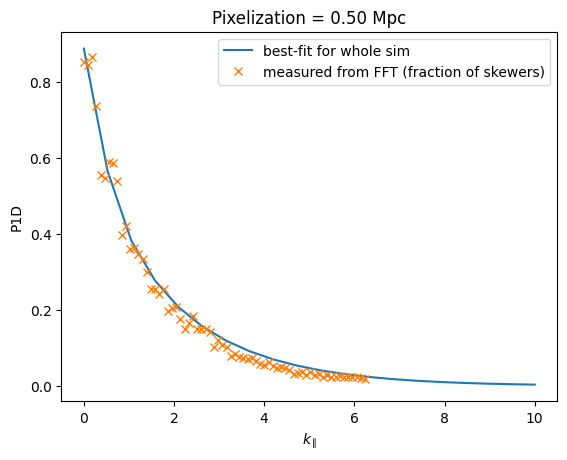

In [60]:
# plt.plot(kpar[1:5], P_kpar_est, 'o', label='estimate')
# plt.plot(kpar[1:], p1d[1:], label='fiducial')
# plt.plot(kpar[1:13], 2*p1d[1:13], label='2x best-fit for whole sim')

plt.plot(np.linspace(0, 10, 20), p1d, label='best-fit for whole sim')
plt.plot(kpar_b, pk_avg, marker = 'x', linestyle='none', label='measured from FFT (fraction of skewers)')
plt.legend()
plt.ylabel("P1D")
plt.xlabel("$k_\parallel$")
plt.title("Pixelization = {:.2f} Mpc".format(pix_spacing_b))

# Compute the $p_\alpha$ estimates

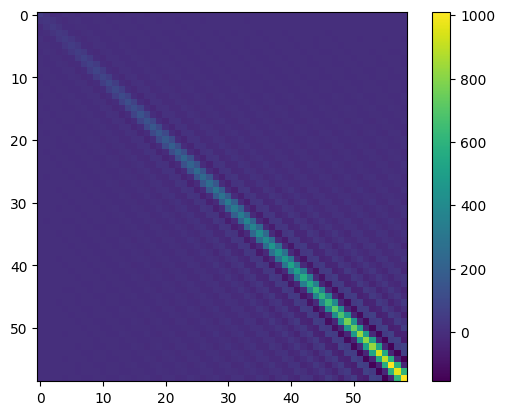

In [111]:
plt.imshow(F_alpha_beta_small)
plt.colorbar()

In [109]:
F_inv = np.linalg.inv(F_alpha_beta)
F_inv_small = np.linalg.inv(F_alpha_beta_small)
F_inv_lrg = np.linalg.inv(F_alpha_beta_lrg)

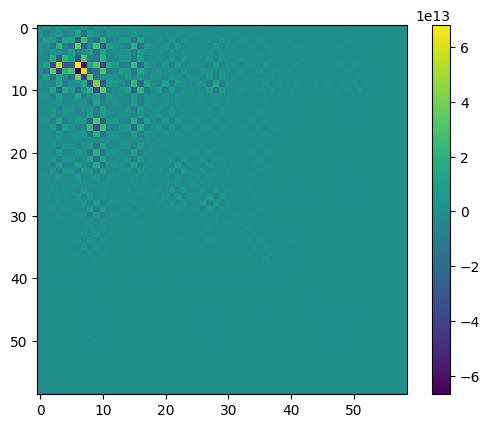

In [110]:
plt.imshow(F_inv_small)
plt.colorbar()

Text(0.5, 0, '$k_\\parallel$')

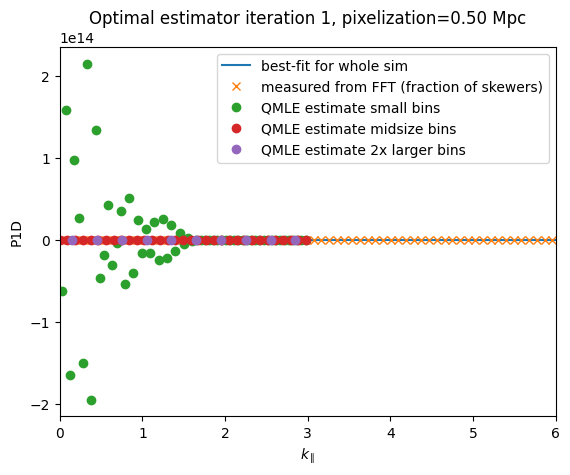

In [112]:
# plt.plot(kpar[1:5], P_kpar_est, 'o', label='estimate')
# plt.plot(kpar[1:], p1d[1:], label='fiducial')
# plt.plot(kpar[1:13], 2*p1d[1:13], label='2x best-fit for whole sim')

plt.plot(np.linspace(0, 10, 20), p1d, label='best-fit for whole sim')
plt.plot(kpar_b[1:], pk_avg[1:], marker = 'x', linestyle='none', label='measured from FFT (fraction of skewers)')

# plt.plot(kpar[1:9], p1d[1:9]+theta_est, 'o', label='QMLE estimate')
plt.plot(kbin_centers_small,theta_est_small, 'o', label='QMLE estimate small bins') # /4.8
plt.plot(kbin_centers,theta_est, 'o', label='QMLE estimate midsize bins') # /4.8
plt.plot(kbin_centers_lrg,theta_est_lrg, 'o', label='QMLE estimate 2x larger bins') # /4.8
# plt.plot(kbin_centers, arinyo.P1D_Mpc(zs[0], np.asarray(kbin_centers), parameters=arinyo_params)+ theta_est, 'o', label='QMLE estimate')
# plt.ylim([0.,1.3])

plt.xlim([0,6])
plt.legend()
plt.title("Optimal estimator iteration 1, pixelization={:.2f} Mpc".format(pix_spacing_b))
plt.ylabel("P1D")
plt.xlabel("$k_\parallel$")

In [1092]:
np.fft.rfftfreq(Np_b, pix_spacing_b)

array([0.        , 0.01481481, 0.02962963, 0.04444444, 0.05925926,
       0.07407407, 0.08888889, 0.1037037 , 0.11851852, 0.13333333,
       0.14814815, 0.16296296, 0.17777778, 0.19259259, 0.20740741,
       0.22222222, 0.23703704, 0.25185185, 0.26666667, 0.28148148,
       0.2962963 , 0.31111111, 0.32592593, 0.34074074, 0.35555556,
       0.37037037, 0.38518519, 0.4       , 0.41481481, 0.42962963,
       0.44444444, 0.45925926, 0.47407407, 0.48888889, 0.5037037 ,
       0.51851852, 0.53333333, 0.54814815, 0.56296296, 0.57777778,
       0.59259259, 0.60740741, 0.62222222, 0.63703704, 0.65185185,
       0.66666667, 0.68148148, 0.6962963 , 0.71111111, 0.72592593,
       0.74074074, 0.75555556, 0.77037037, 0.78518519, 0.8       ,
       0.81481481, 0.82962963, 0.84444444, 0.85925926, 0.87407407,
       0.88888889, 0.9037037 , 0.91851852, 0.93333333, 0.94814815,
       0.96296296, 0.97777778, 0.99259259])

In [1091]:
kpar_b

array([0.        , 0.09308423, 0.18616845, 0.27925268, 0.37233691,
       0.46542113, 0.55850536, 0.65158959, 0.74467381, 0.83775804,
       0.93084227, 1.02392649, 1.11701072, 1.21009495, 1.30317917,
       1.3962634 , 1.48934763, 1.58243186, 1.67551608, 1.76860031,
       1.86168454, 1.95476876, 2.04785299, 2.14093722, 2.23402144,
       2.32710567, 2.4201899 , 2.51327412, 2.60635835, 2.69944258,
       2.7925268 , 2.88561103, 2.97869526, 3.07177948, 3.16486371,
       3.25794794, 3.35103216, 3.44411639, 3.53720062, 3.63028484,
       3.72336907, 3.8164533 , 3.90953752, 4.00262175, 4.09570598,
       4.1887902 , 4.28187443, 4.37495866, 4.46804289, 4.56112711,
       4.65421134, 4.74729557, 4.84037979, 4.93346402, 5.02654825,
       5.11963247, 5.2127167 , 5.30580093, 5.39888515, 5.49196938,
       5.58505361, 5.67813783, 5.77122206, 5.86430629, 5.95739051,
       6.05047474, 6.14355897, 6.23664319])

In [1090]:
134/2/(.5*135)

0.9925925925925926

# how do we get the $p_\alpha$ estimates?
(1) Make a first guess for $p_\alpha$

(2) At every iteration compute the covariance matrix using the previous estimates for $p_\alpha$

The covariance matrix is $C = S + N$


(3) Compute $d_\alpha$, $b_\alpha$, $t_\alpha$ as in Naim 4,5,6 -- these have the observed $\delta_F$ vectors

(4) Compute

$$ \hat{p}_\alpha^{(X+1)} = \Sigma_{\alpha'} \frac{1}{2}F^{-1}_{\alpha \alpha'} (d_{\alpha'}-b_{\alpha'}-t_{\alpha'})$$

which is effectively giving the inverse-variance-weighted average of the residuals at each iteration.

(5)  Compute Fisher matrix. Note that this needs to consider all redshift bins that the spectrum spans.

(6) Check for convergence using eqns in 3.3 (Naim)

Notes from Andreu's paper:
Make the fiducial power spectrum P1D
